# <center> **Astronomical Data Analysis** (ADS)


### ** Advanced Image Processing, Data Analysis and Machine Learning (CNN).**

In [ ]:
# mandatory
My_name: "Adwaita Basu Bal"
My_email_id: "21053229@kiit.ac.in"

Image Denoising using Median Filter :


 Image downloaded and saved as galaxy.jpg 




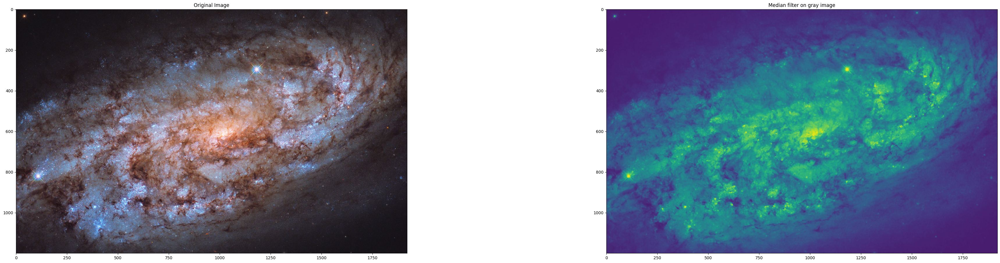

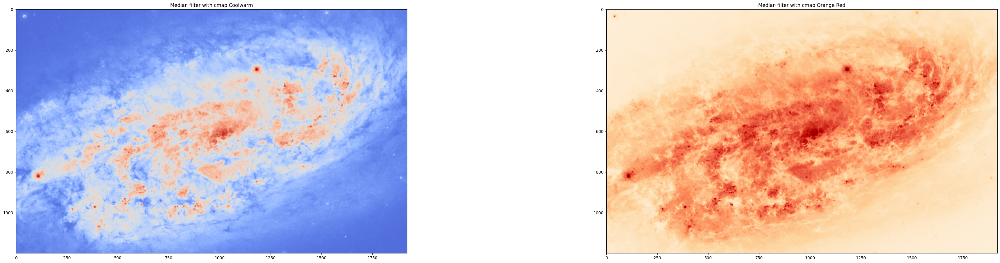

In [ ]:
# write your solution here

# import libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2
import urllib.request
from skimage import io
from skimage.filters import median
from skimage.morphology import disk


# image download
kaggle = 'https://cdn.spacetelescope.org/archives/images/wallpaper4/potw2049a.jpg'
galaxy_image = "galaxy.jpg"

urllib.request.urlretrieve(kaggle, galaxy_image)
print(f"\n Image downloaded and saved as {galaxy_image} \n\n")


#image filtering
image = plt.imread(galaxy_image)
image_gray = io.imread(galaxy_image,as_gray=True)

median_using_skimage = median(image_gray, disk(3), mode='constant')



#image plotting
plt.figure(figsize=(48, 24))
plt.subplot(2, 2, 1)
plt.imshow(image)
plt.title('Original Image')

plt.subplot(2, 2, 2)
plt.imshow(median_using_skimage)
plt.title('Median filter on gray image')
plt.show()

plt.figure(figsize=(48, 24))
plt.subplot(2, 2, 3)
plt.imshow(median_using_skimage, cmap = 'coolwarm')
plt.title('Median filter with cmap Coolwarm')

plt.subplot(2, 2, 4)
plt.imshow(median_using_skimage, cmap ='OrRd')
plt.title('Median filter with cmap Orange Red')
plt.show()


#random drives already added
#https://drive.google.com/file/d/1h7ahuDUOXI-uO77R5Zlf-2d4Gr41naiN/view?usp=drive_link
#https://drive.google.com/uc?id=1h7ahuDUOXI-uO77R5Zlf-2d4Gr41naiN

# <center> **Galaxy NGC 6946 Analysis** (ADS)

P.S. The code works! just takes a bit of time to execute. Please be patient!

In [ ]:
!pip install astroquery
!pip install astropy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 20.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 888.9/888.9 kB 39.3 MB/s eta 0:00:00


I imported SkyView to use the FITS file and image of NGC 6946 from the site.It will be used for further analysis.

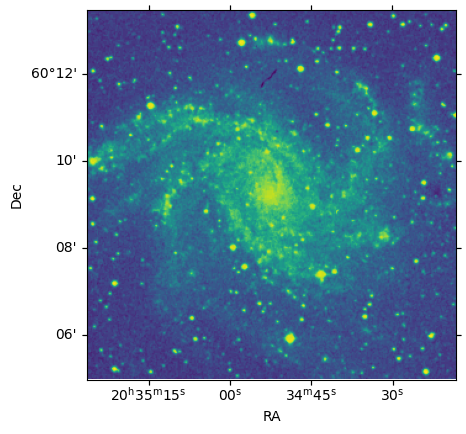

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

from astroquery.skyview import SkyView
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS

# Query for SDSS g images centered on target name
hdu = SkyView.get_images("NGC6946", survey='DSS')[0][0]
# Tell matplotlib how to plot WCS axes
wcs = WCS(hdu.header)
fig = plt.figure()
ax = fig.add_subplot(projection=wcs)

# Plot the image
ax.imshow(hdu.data)
ax.set(xlabel="RA", ylabel="Dec")
plt.show()

To avoid confusion, I would like to mention that for the literature survey, I also imported a separate image from nasa's official website just to show the galaxy.


 Image downloaded and saved as fireworks_6946.jpg 




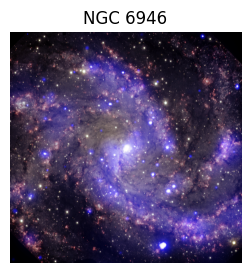


Literature Survey of Galaxy NGC 6946:

1. NGC 6946 is a nearby double-barred spiral galaxy located in the constellation Cepheus.

2. The galactic latitude and longitude of NGC 6946 are approximately 85.5 degrees and 24.4 degrees, respectively.

3. NGC 6946 is known as the Fireworks Galaxy due to its high rate of supernova explosions and star formation, with
   10 supernovas observed between 1917 and 2008.

4.  Kim (1984) studied the structure of NGC 6946 and found it has a deep spheroidal component caused by a ring structure in its center.
    Lacey (1997) surveyed compact radio sources in NGC 6946, detecting 118 sources and identifying many as possible supernova remnants,
    H II regions, or sources with inverted spectra. Additionally, the existence of magnetic spiral arms in the galaxy has been studied.

5.  Based on this literature survey, I hypothesize that NGC 6946 likely hosts an active supermassive black hole at its center, given that
    its nucleus is obscured, its spiral ar

In [ ]:
# Write your ans here
import matplotlib.pyplot as plt
from skimage import io
import urllib.request

nasa = 'https://www.nasa.gov/sites/default/files/archives_ngc6946.jpg'
galaxy_6946 = "fireworks_6946.jpg"

urllib.request.urlretrieve(nasa, galaxy_6946)
print(f"\n Image downloaded and saved as {galaxy_6946} \n\n")


#image filtering
image3 = plt.imread(galaxy_6946)

#image plotting
plt.figure(figsize=(6, 3))
plt.imshow(image3)
plt.axis('off')
plt.title('NGC 6946')
plt.show()

#Literature survey
print('''
Literature Survey of Galaxy NGC 6946:

1. NGC 6946 is a nearby double-barred spiral galaxy located in the constellation Cepheus.

2. The galactic latitude and longitude of NGC 6946 are approximately 85.5 degrees and 24.4 degrees, respectively.

3. NGC 6946 is known as the Fireworks Galaxy due to its high rate of supernova explosions and star formation, with
   10 supernovas observed between 1917 and 2008.

4.  Kim (1984) studied the structure of NGC 6946 and found it has a deep spheroidal component caused by a ring structure in its center.
    Lacey (1997) surveyed compact radio sources in NGC 6946, detecting 118 sources and identifying many as possible supernova remnants,
    H II regions, or sources with inverted spectra. Additionally, the existence of magnetic spiral arms in the galaxy has been studied.

5.  Based on this literature survey, I hypothesize that NGC 6946 likely hosts an active supermassive black hole at its center, given that
    its nucleus is obscured, its spiral arms and its intense star formation.
    ''')

On the imported image:
- Performing the exploratory data analysis (will the information about dataset) and image processing on the data.
- Moreover, will be writing points of inference from the EDA performed.

Creating the FITS file based on imported image.

In [ ]:
from astropy.io import fits
NGC6946 = hdu
type(NGC6946)
NGC6946_header = NGC6946.header
NGC6946_pixels = NGC6946.data

hdulist = fits.HDUList()
hdu1 = fits.PrimaryHDU()
hdu1.data = NGC6946_pixels
hdu1.header = NGC6946_header
hdulist.append(hdu1)

hdulist.writeto('NGC6946_galaxy_data.fits')

Opening the FITS file

In [ ]:
My_fits = fits.open('/content/NGC6946_galaxy_data.fits')
My_fits.info()
NGC6946_data = My_fits[0].data

Filename: /content/NGC6946_galaxy_data.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     167   (300, 300)   float32   


In [ ]:
import numpy as np
from astropy.io import fits
import astropy

print('Min:', np.min(NGC6946_data))
print('Max:', np.max(NGC6946_data))
print('Mean:', np.mean(NGC6946_data))
print('Stdev:', np.std(NGC6946_data))

Min: 1173.0
Max: 14066.0
Mean: 5439.2354
Stdev: 2071.2349


Starting the EDA with Pixel Scaling

In [ ]:
NGC6946_data[150,150]       #Value at 100,100

12871.0

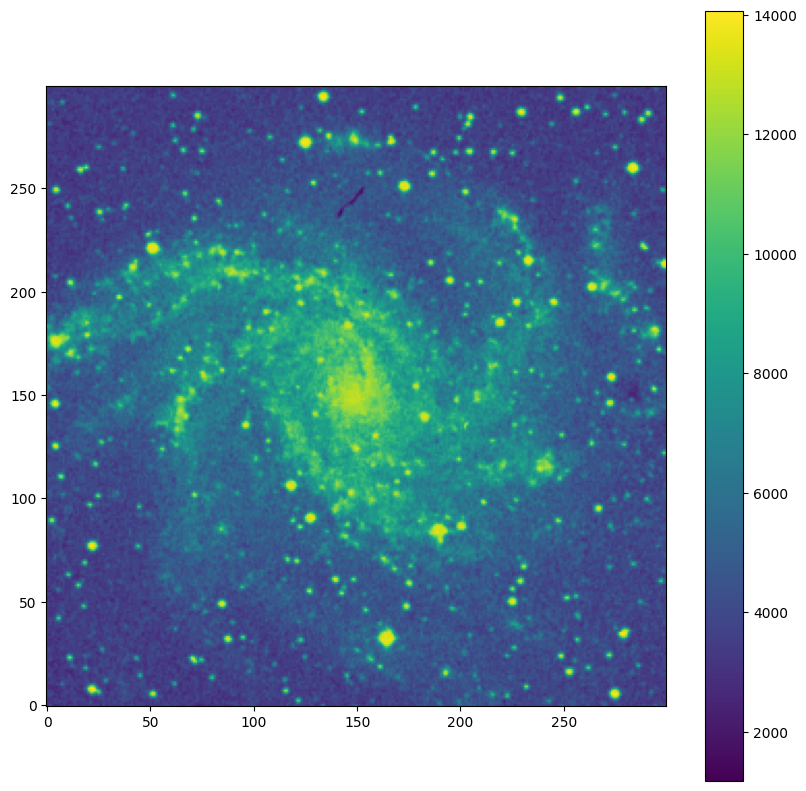

In [ ]:
import matplotlib.pyplot as plt
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.imshow(NGC6946_data, origin = 'lower')
plt.colorbar()

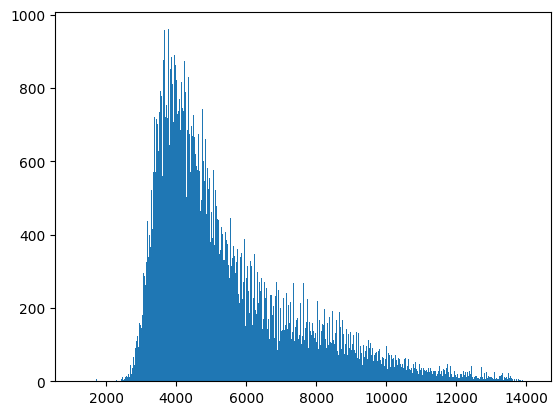

In [ ]:
histogram = plt.hist(NGC6946_data.flat, bins=500)

Normalization of the image

In [ ]:
def Normalize(img):
  lmin = float(img.min())
  lmax = float(img.max())
  return np.floor((img-lmin)/(lmax-lmin))

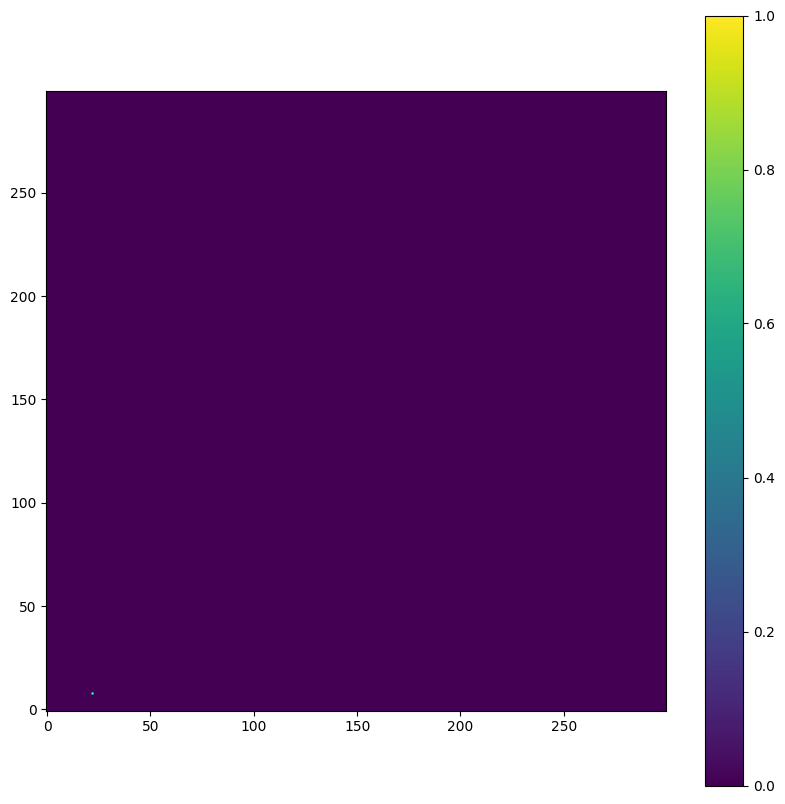

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.imshow(Normalize(NGC6946_data), origin = 'lower')
plt.colorbar()

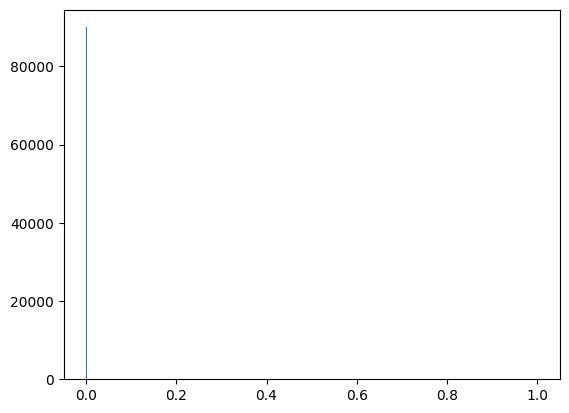

In [ ]:
Normalize_image = Normalize(NGC6946_data)
histogram = plt.hist(Normalize_image.flat, bins=500)

Standardization of the data

In [ ]:
def Standardization(img):
  lmean = float(np.mean(img))
  lstd = float(np.std(img))
  return np.floor((img-lmean)/(lstd))

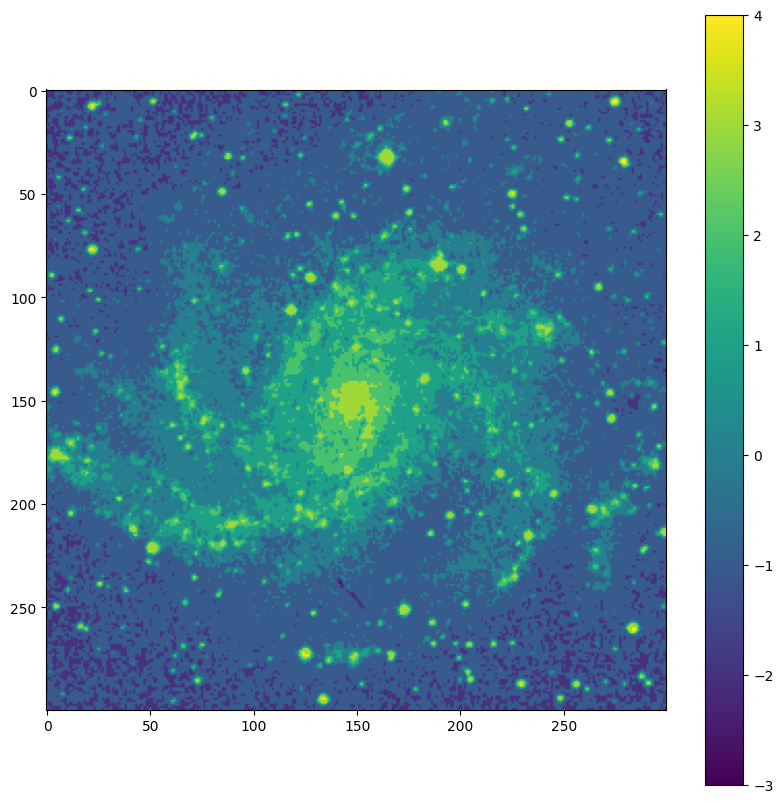

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.imshow(Standardization(NGC6946_data))
plt.colorbar()

Log Normalization of the data

In [ ]:
def log_Normalize(img):
  return np.log(img)

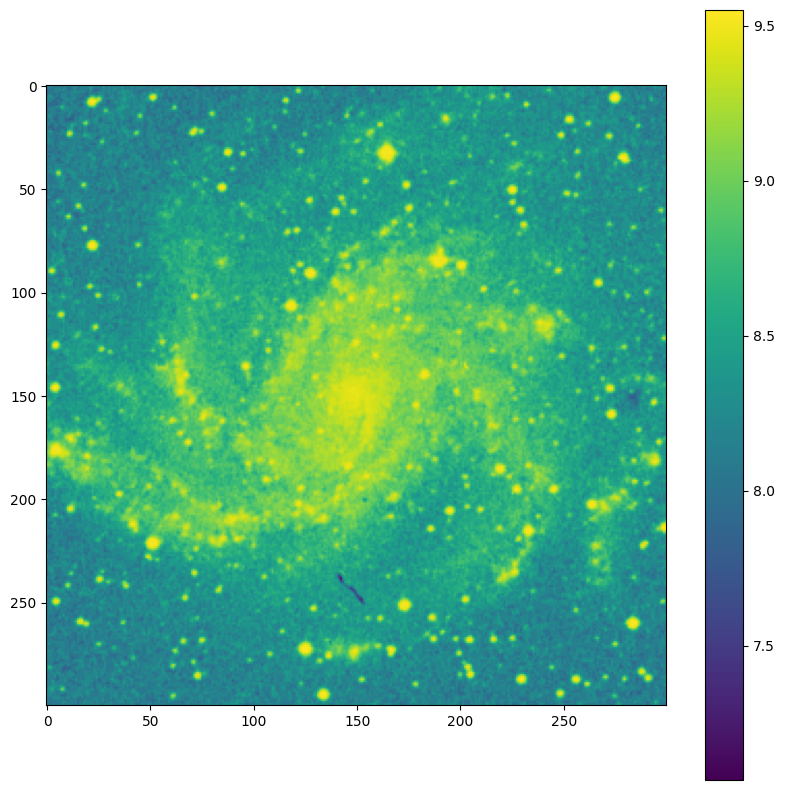

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.imshow(log_Normalize(NGC6946_data))
plt.colorbar()

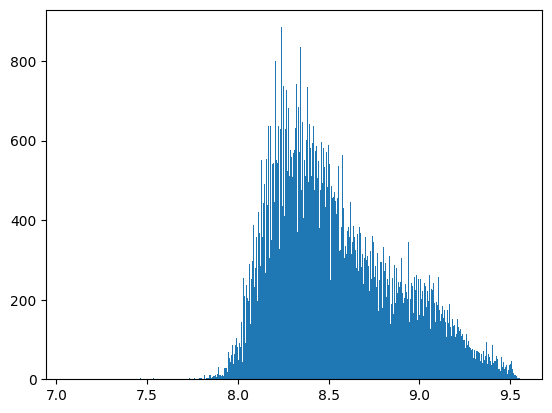

In [ ]:
log_image = log_Normalize(NGC6946_data)
histogram = plt.hist(log_image.flat, bins=500)

Z Scale Intervals

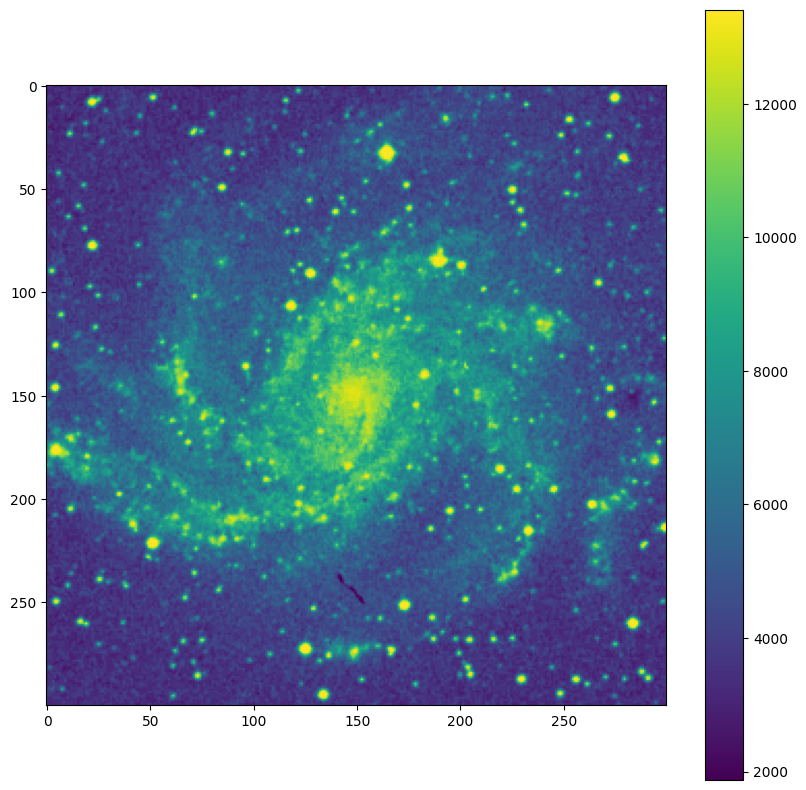

In [ ]:
from astropy.visualization import ZScaleInterval
z = ZScaleInterval()
z1,z2 = z.get_limits(NGC6946_data)

f = plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.imshow(NGC6946_data,vmin=z1,vmax=z2)
plt.colorbar()


My points of inferences from the Data Analysis are :

1) We see that while pixels range throughout the color bar, most pixels remain in the darker region with maximum pixels peaking close to 4000.

2) The very first thing I noted was that the highest luminosity pixels are spread out all over the image. This shows that there is star formation and other
   transformations happening all over the galaxy in high intensity, with
   the intensity increasing towards the center.

2) From the Z scale interval and log normalisation we can very clearly trace the sprial like nature of the galaxy, confirming its identity as a spiral galaxy.

3) There is a very obvious presence of a nucleus containing some of the brightest pixels, especially visible after Z scale Interval. This supports the existance
   of a SMB at the middle.

4) General normalisation is a poor tool for making any inference. However, we see that the brightest pixel is suprisingly not situated anywhere near the center
   of the galaxy.

# <center> **Applying Filters** (ADS)

Filter 1 : Meijering Neuriteness Filter

This filter can be used to detect continuous ridges, e.g. neurites, wrinkles, rivers. It can be used to calculate the fraction of the whole image containing such objects.

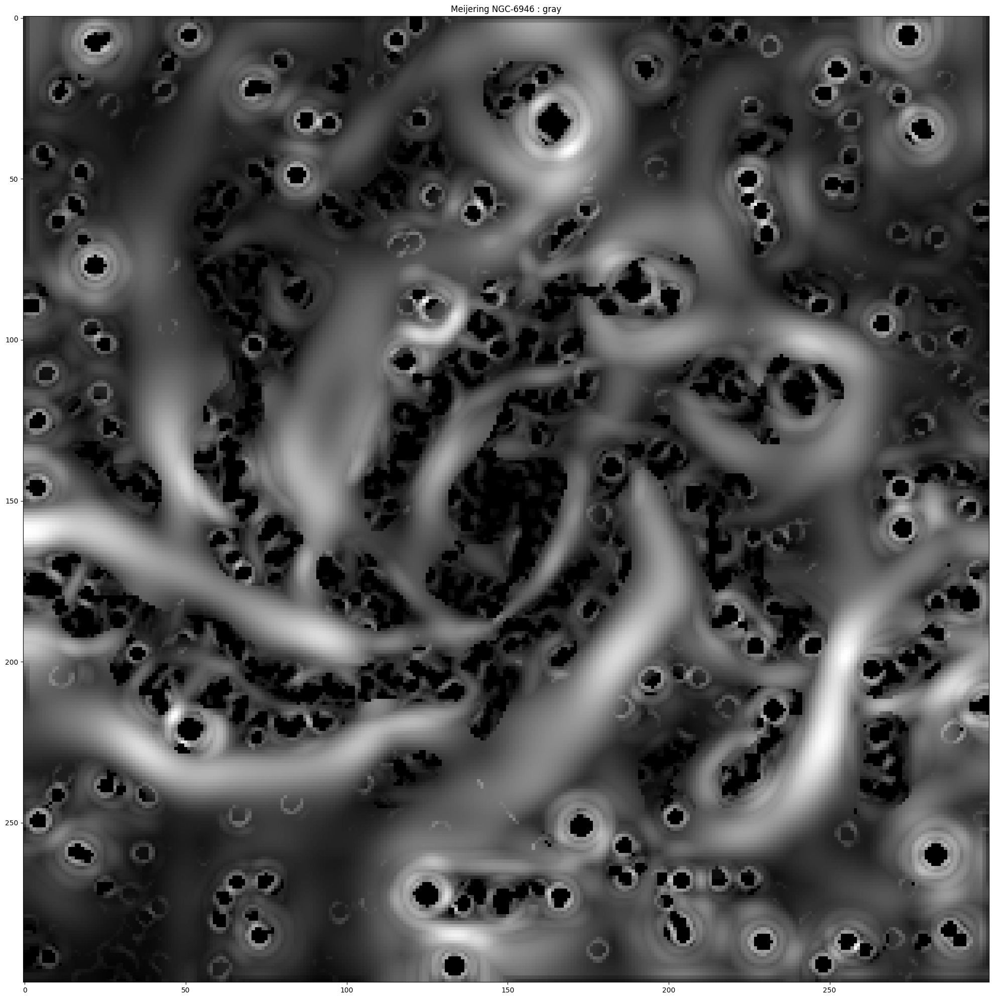

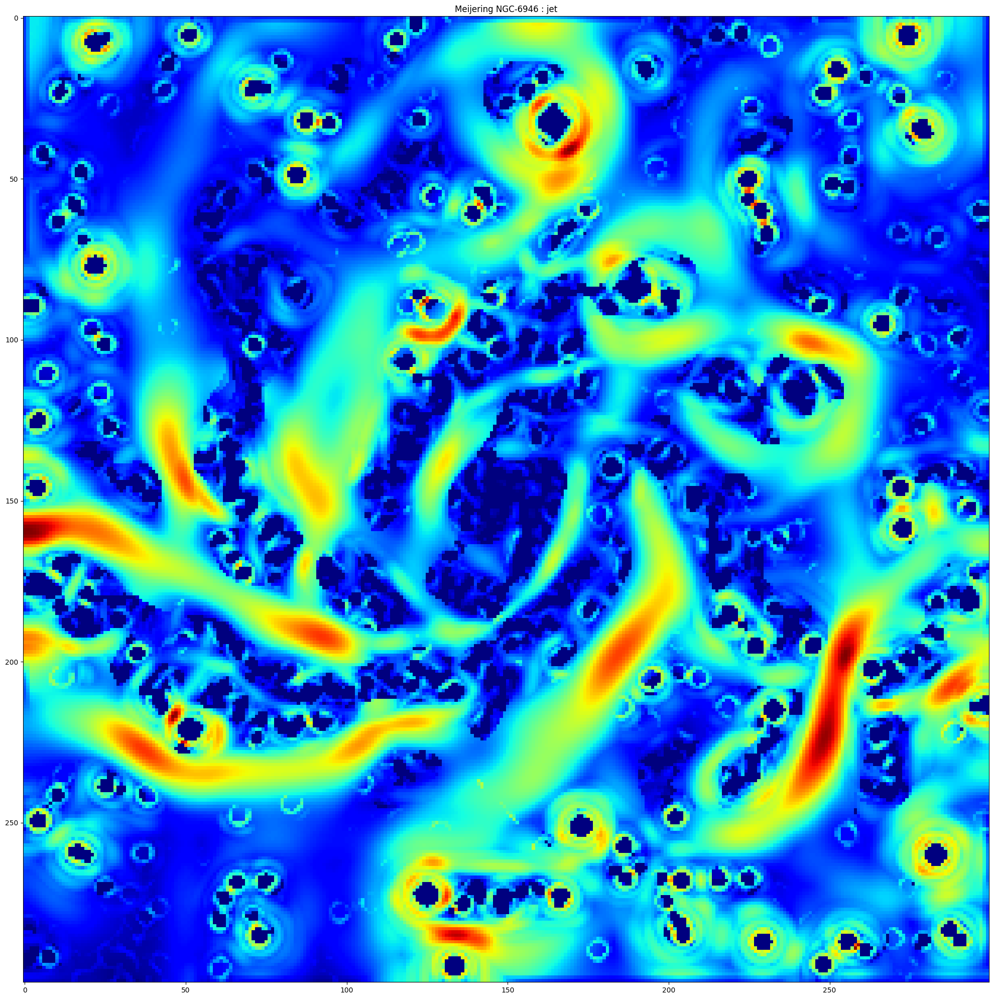

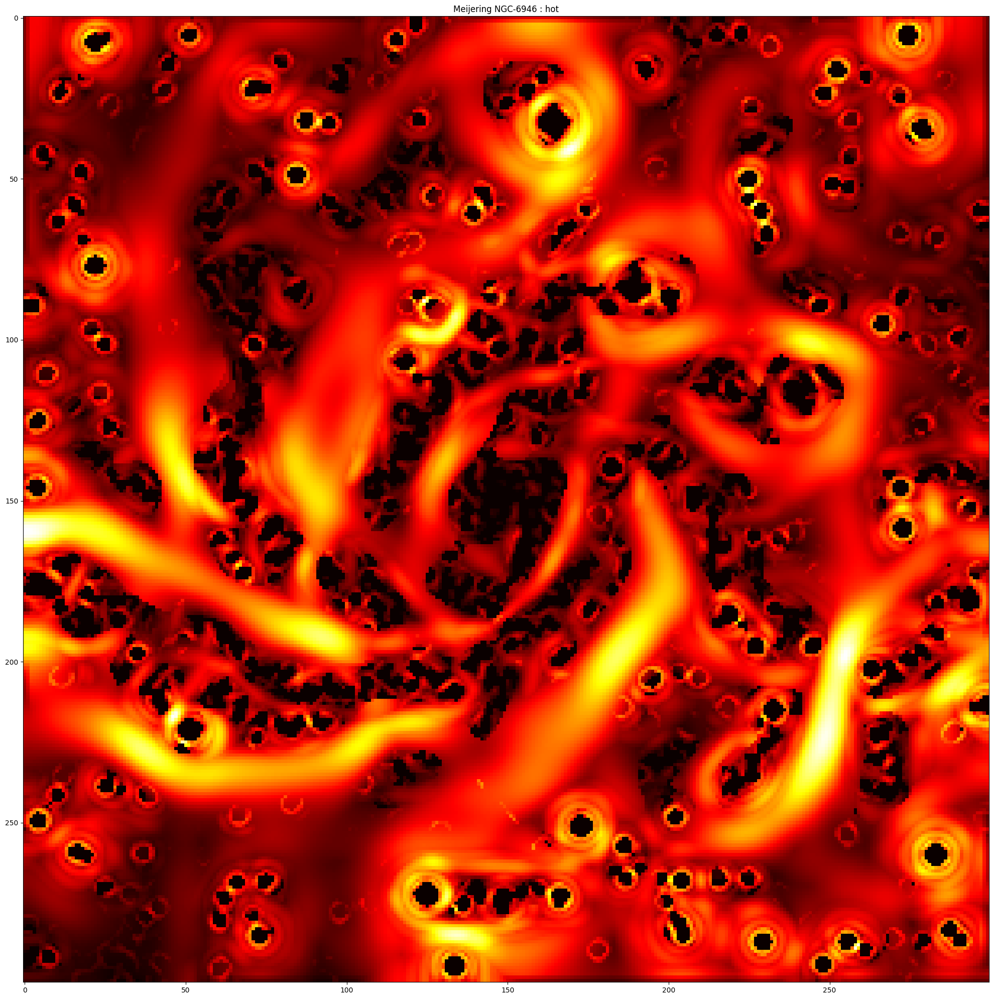

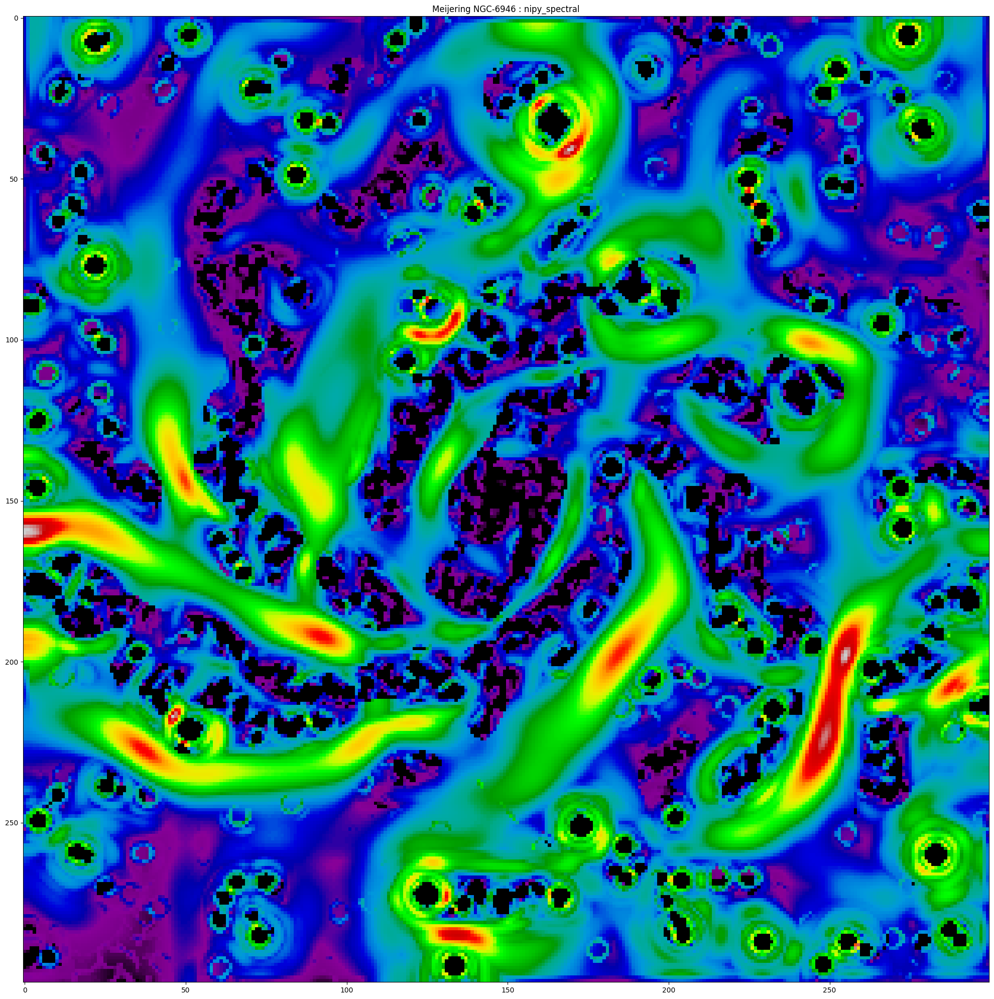

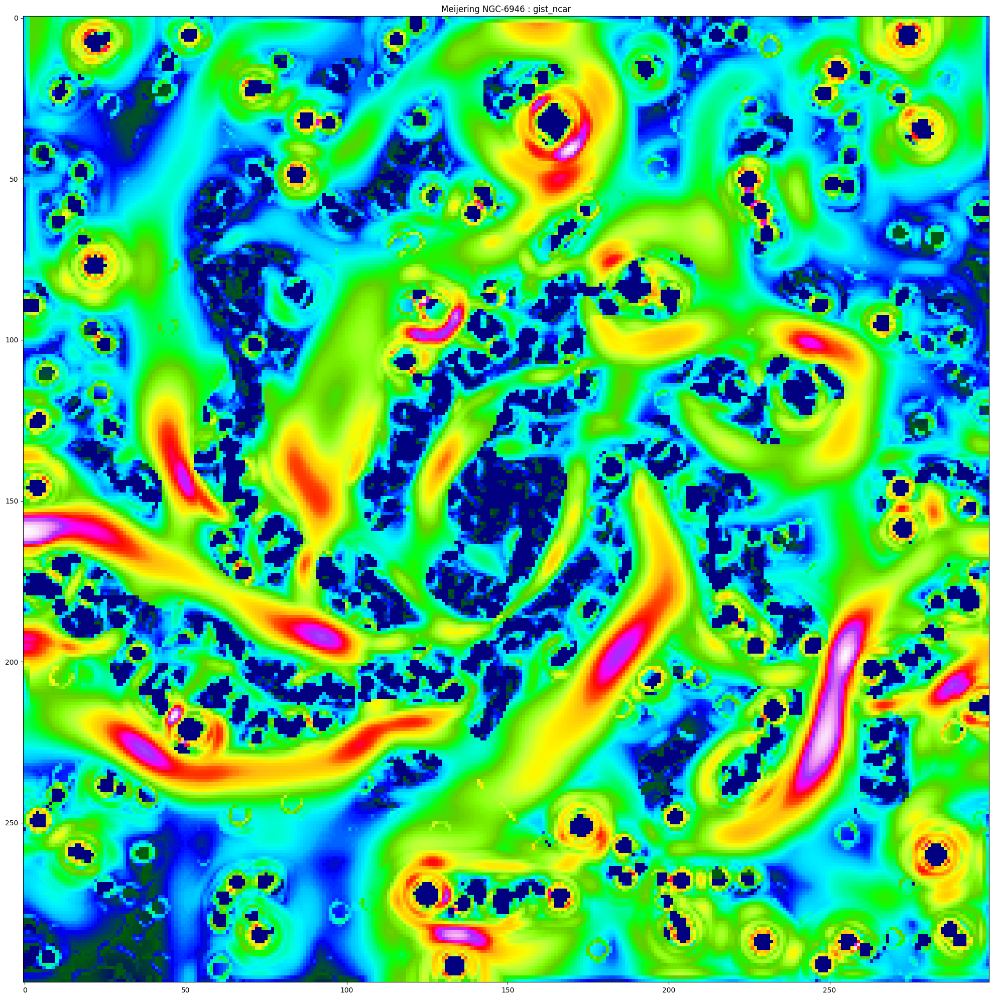

...

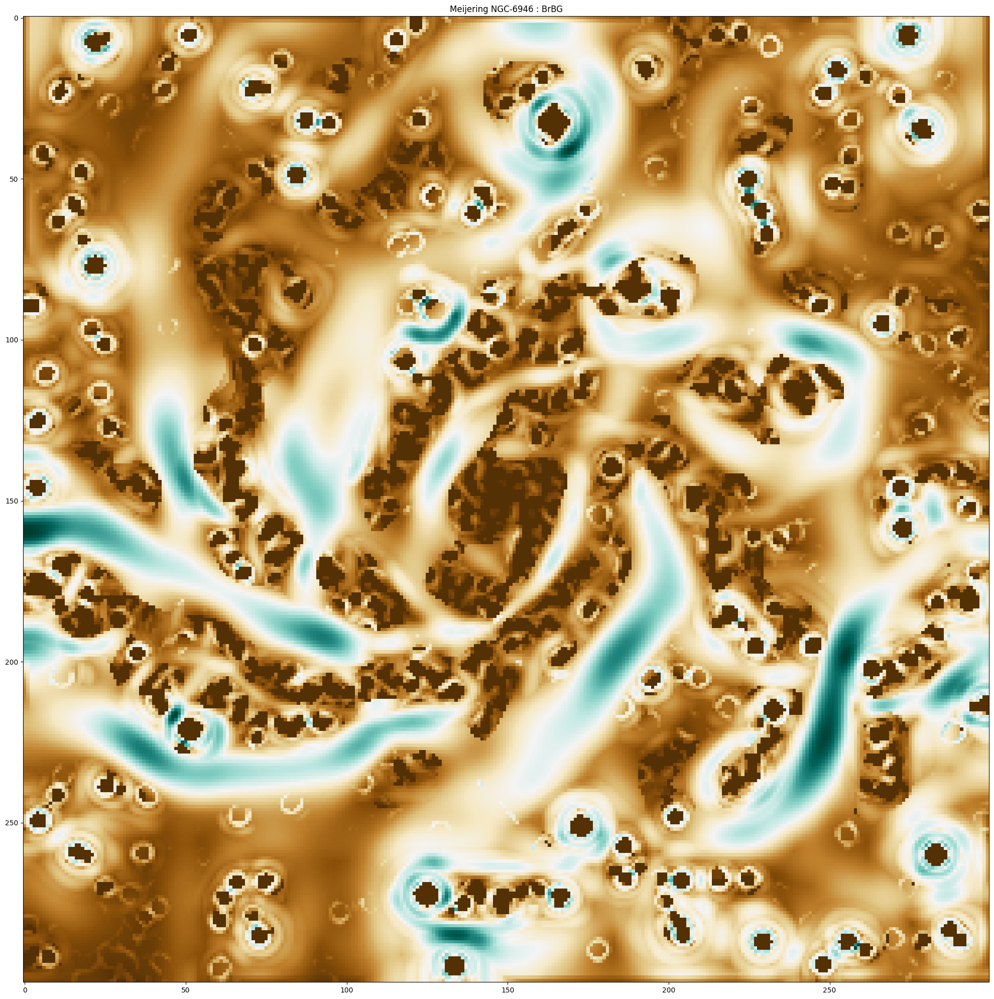

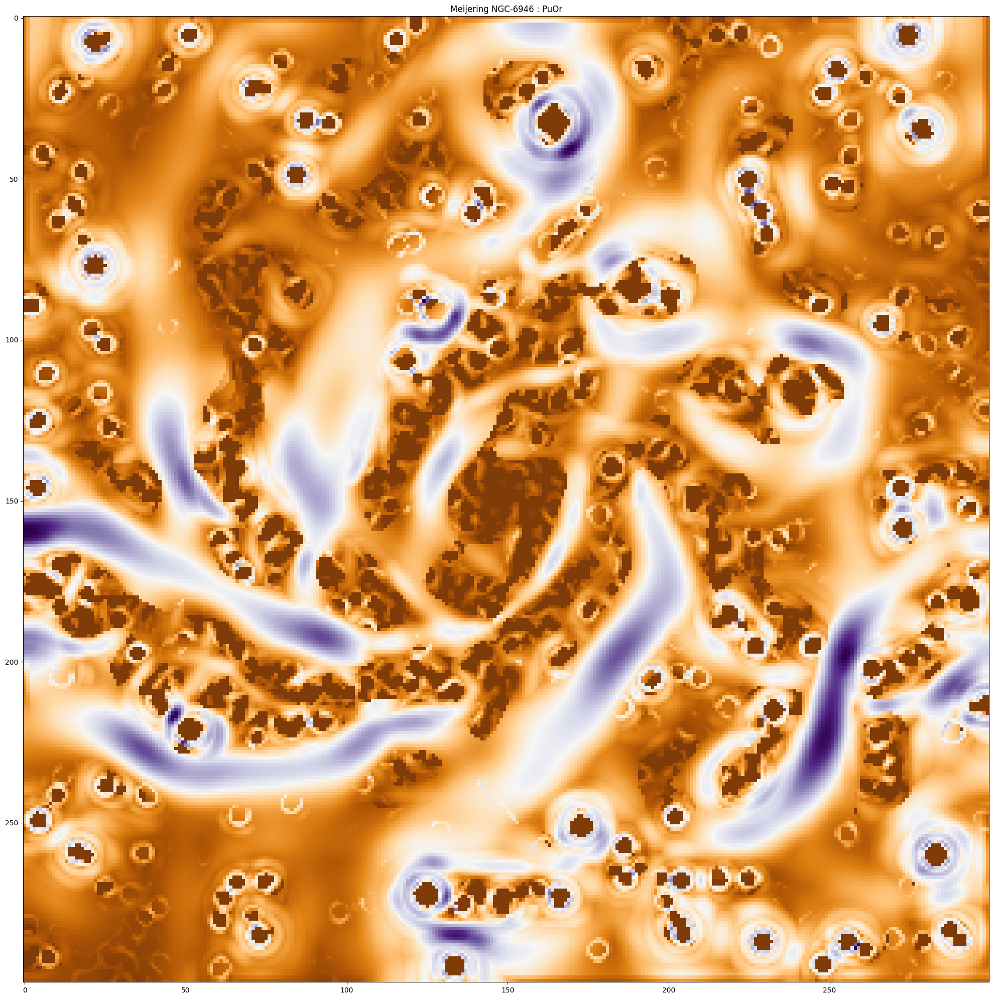

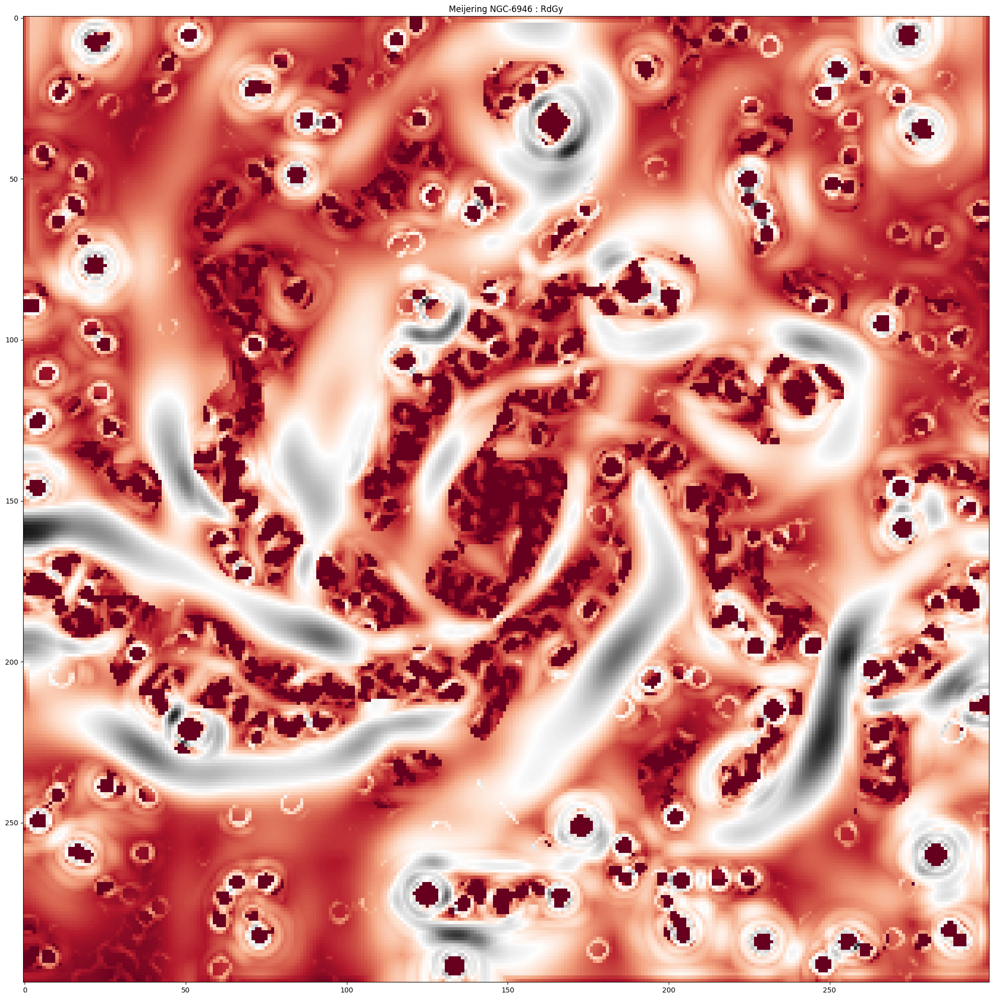

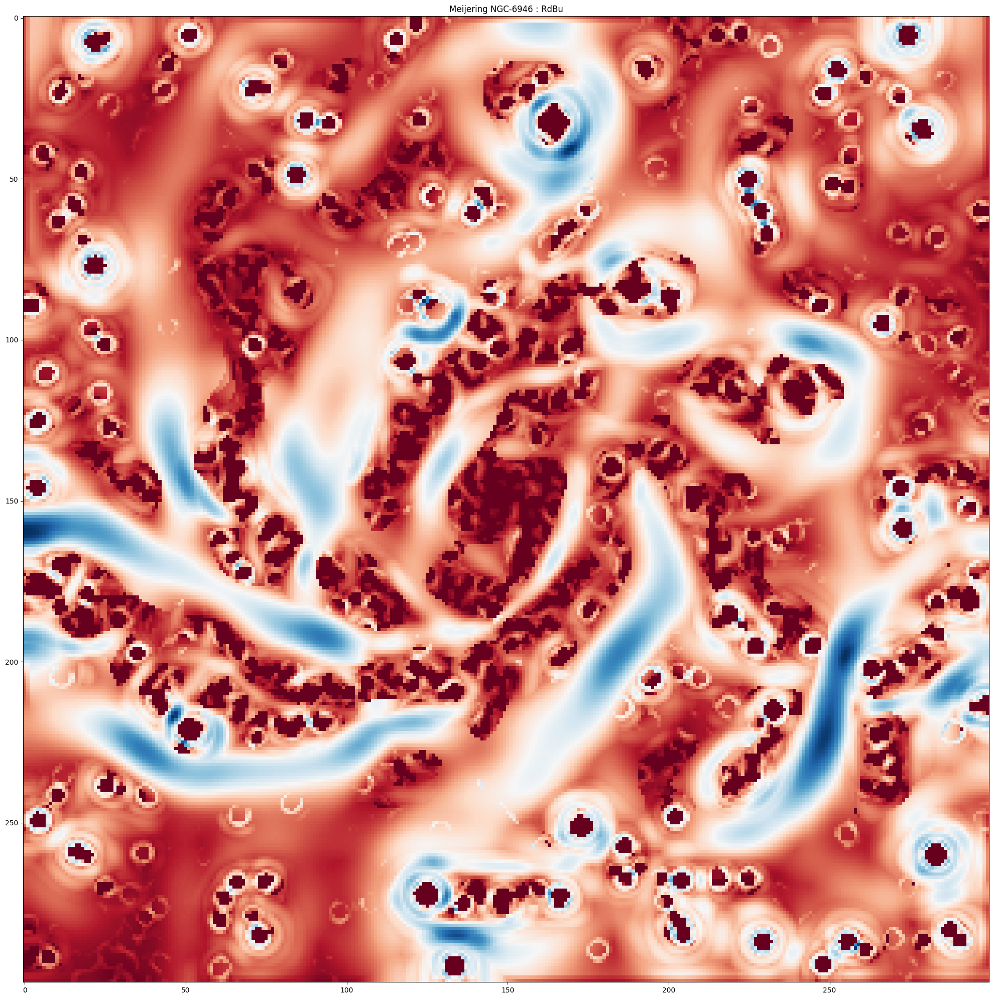

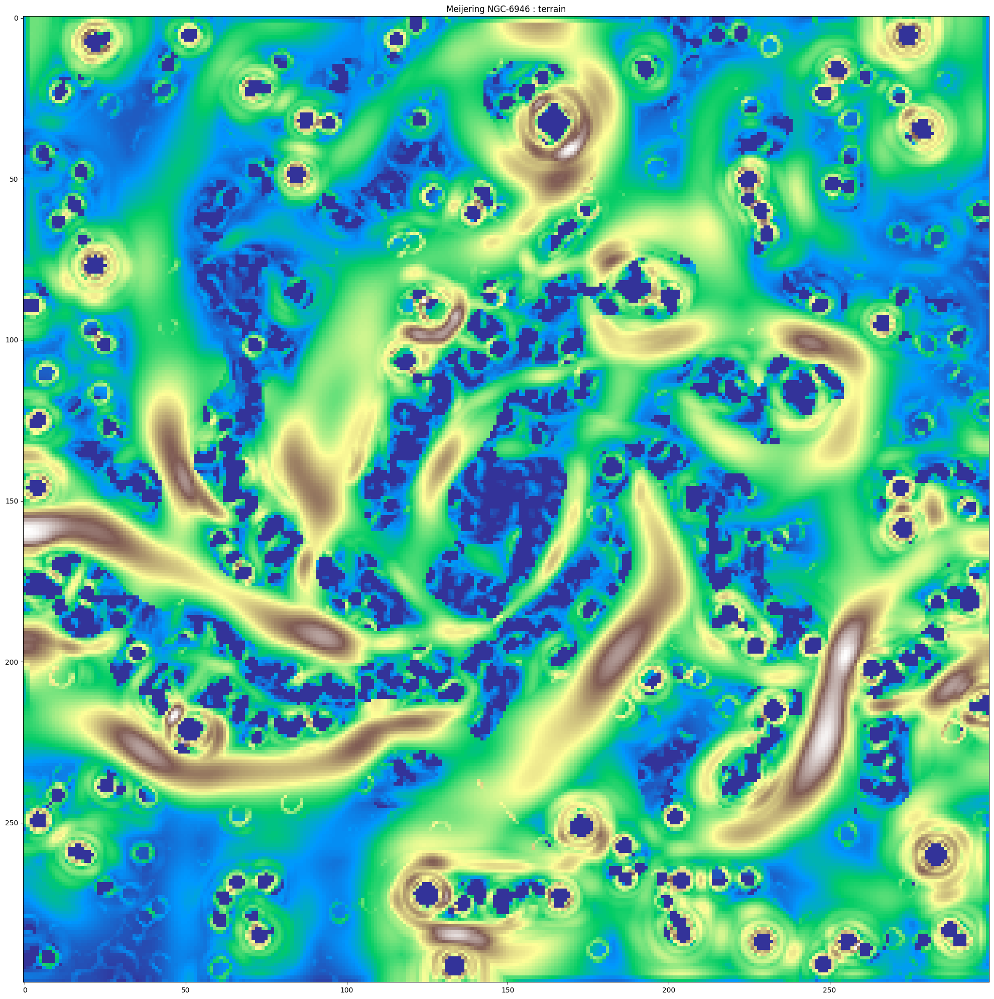

In [ ]:
import matplotlib.pyplot as plt
from skimage.filters import meijering, sato, frangi, hessian

COLORMAP_LIST = ["gray","jet","hot","nipy_spectral",
             "gist_ncar","gist_stern","gnuplot2",
            "bwr",'PiYG','PRGn','BrBG','PuOr','RdGy','RdBu','terrain']

meijering_6946 = meijering(NGC6946_data)

for x_spec in COLORMAP_LIST:

    plt.figure(figsize=(20,20))

    plt.imshow(meijering_6946 ,cmap=x_spec)
    plt.title("Meijering NGC-6946 : " + x_spec)
    plt.tight_layout()
    plt.show()



Insight

From Filter 1 : We see that this filter highlights the more prominent parts of and objects in the given image, circling them out with tube like structures.

This is helpful to trace out the general spiral arms of the galaxy and the more intense spots in it, generally pointing towards more active parts such as star formation.

These are best depicted by the color maps : Jet, nipy_spectral, gist_stem.

Filter 2 : Sato Tubeness Filter

Similiar to Meijering, this filter can be used to detect continuous ridges, e.g. neurites, wrinkles, rivers depicted by tube-like structures. It can be used to calculate the fraction of the whole image containing such objects.

In [ ]:
sato_6946 = sato(NGC6946_data)

for x_spec in COLORMAP_LIST:

    plt.figure(figsize=(20,20))

    plt.imshow(sato_6946 ,cmap=x_spec)
    plt.title("Sato NGC-6946 : " + x_spec)
    plt.tight_layout()
    plt.show()

Insight

From Filter 1 : We see that this filter has outputs almost identical to that of
 Meijering. It highlights the more prominent parts of and objects in the given image, circling them out with tube like structures.

This is helpful to trace out the general spiral arms of the galaxy and the more intense spots in it, generally pointing towards more active parts such as star formation.

These are again, best depicted by the color maps : Jet, nipy_spectral, gist_stem.

Filter 3 : Frangi Vesselness Filter

Similiar to Meijering, this filter can be used to detect continuous ridges, e.g. vessels, wrinkles, rivers depicted by tube-like structures. It can be used to calculate the fraction of the whole image containing such objects.

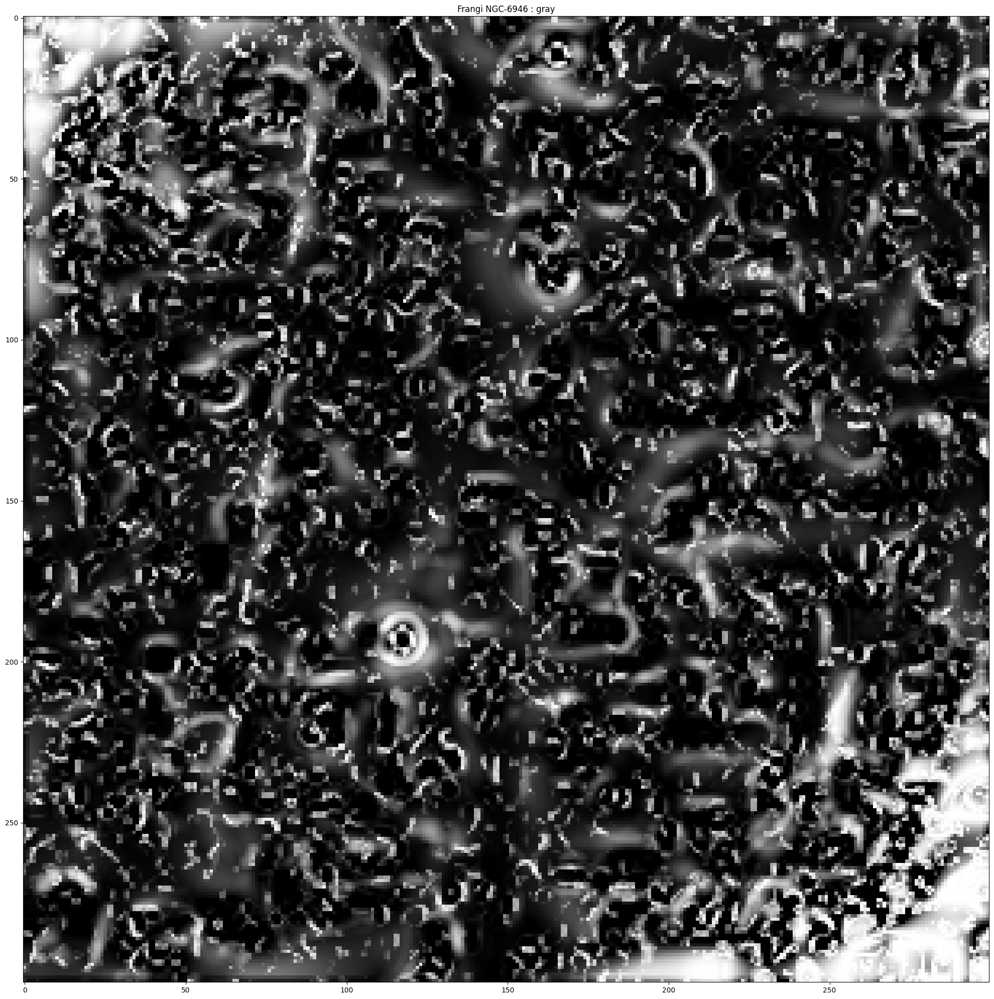

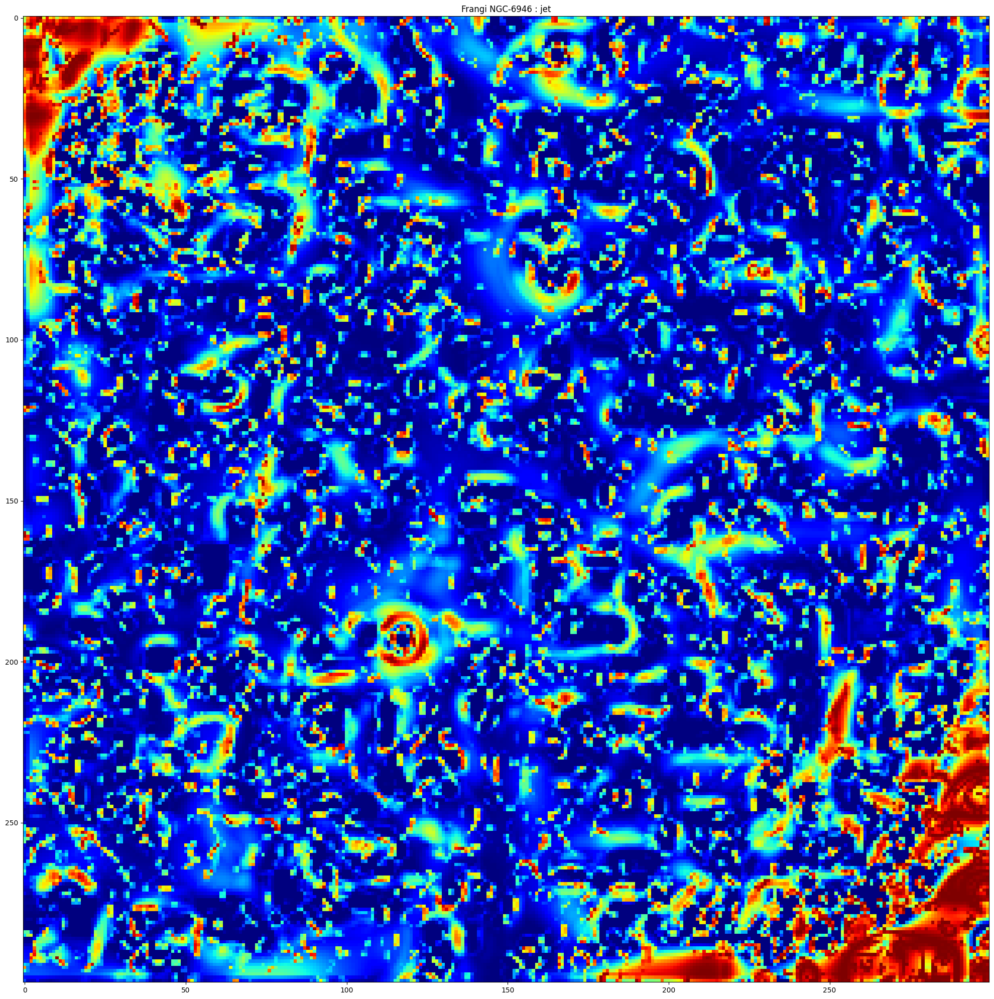

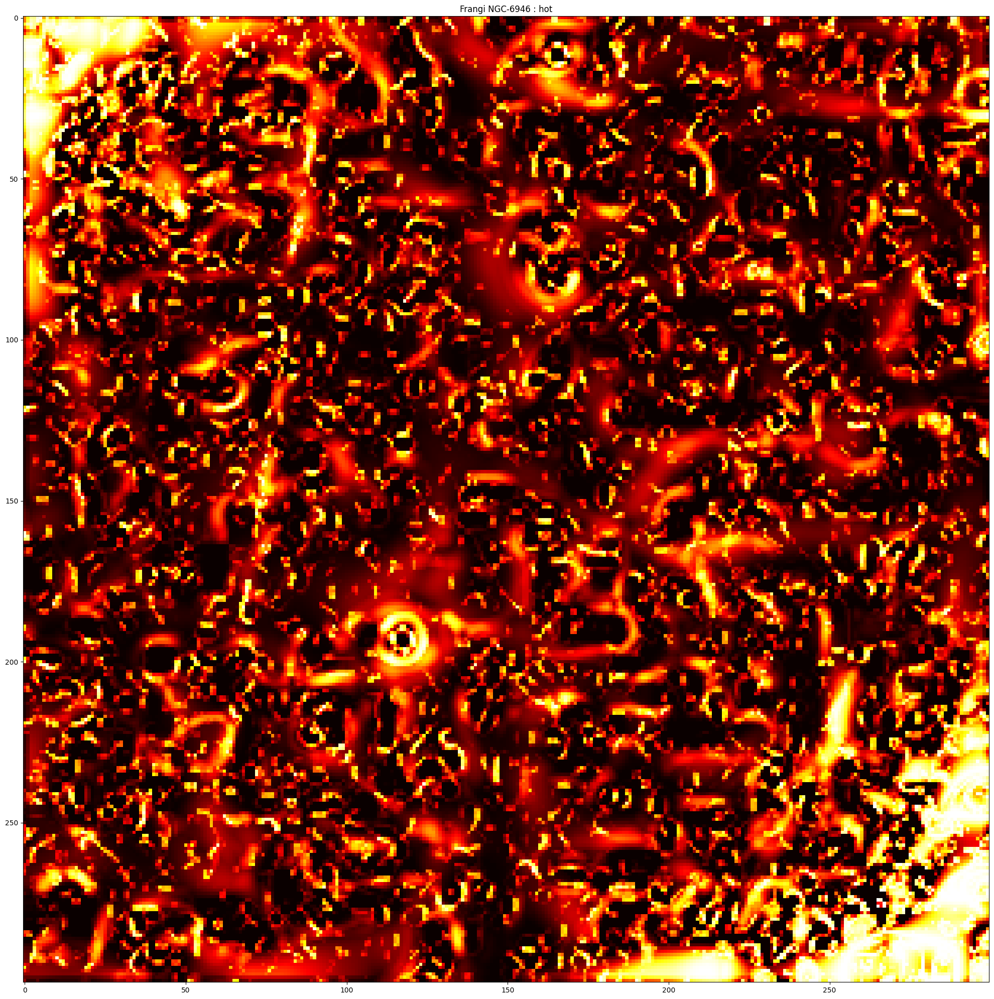

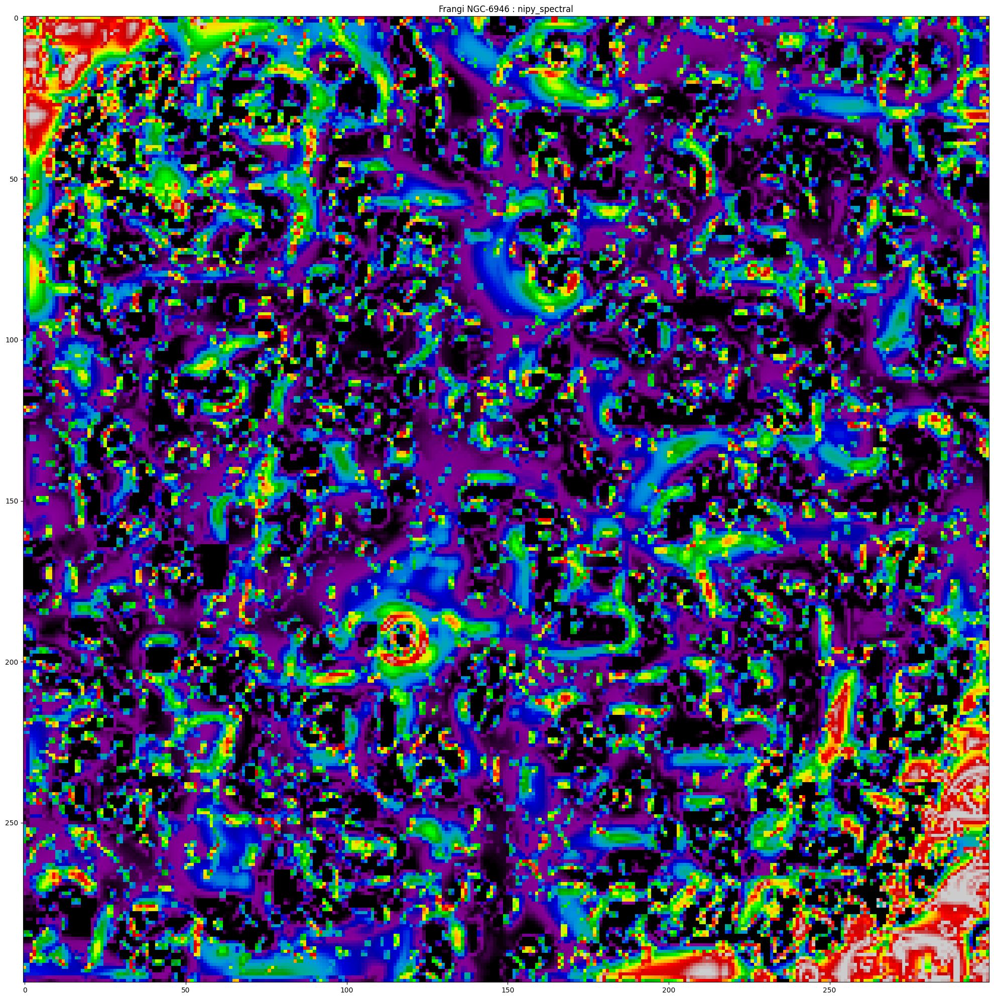

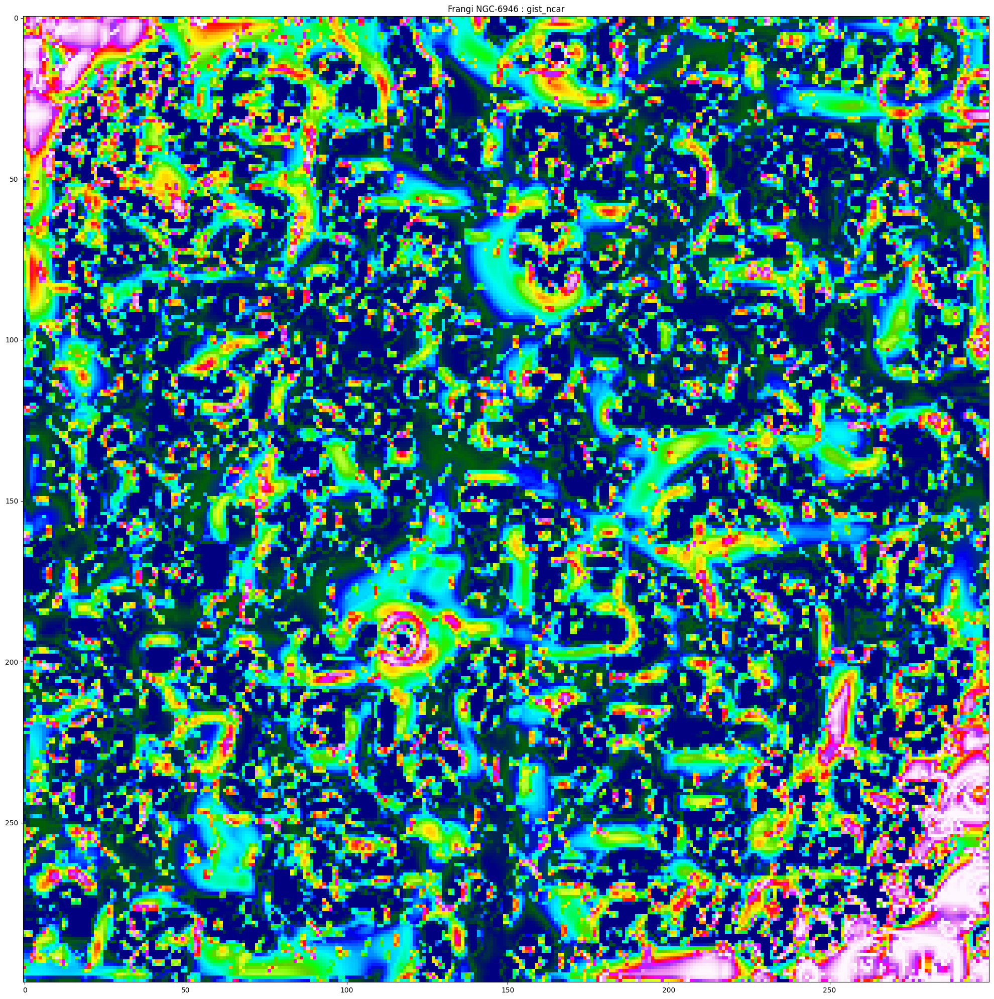

...

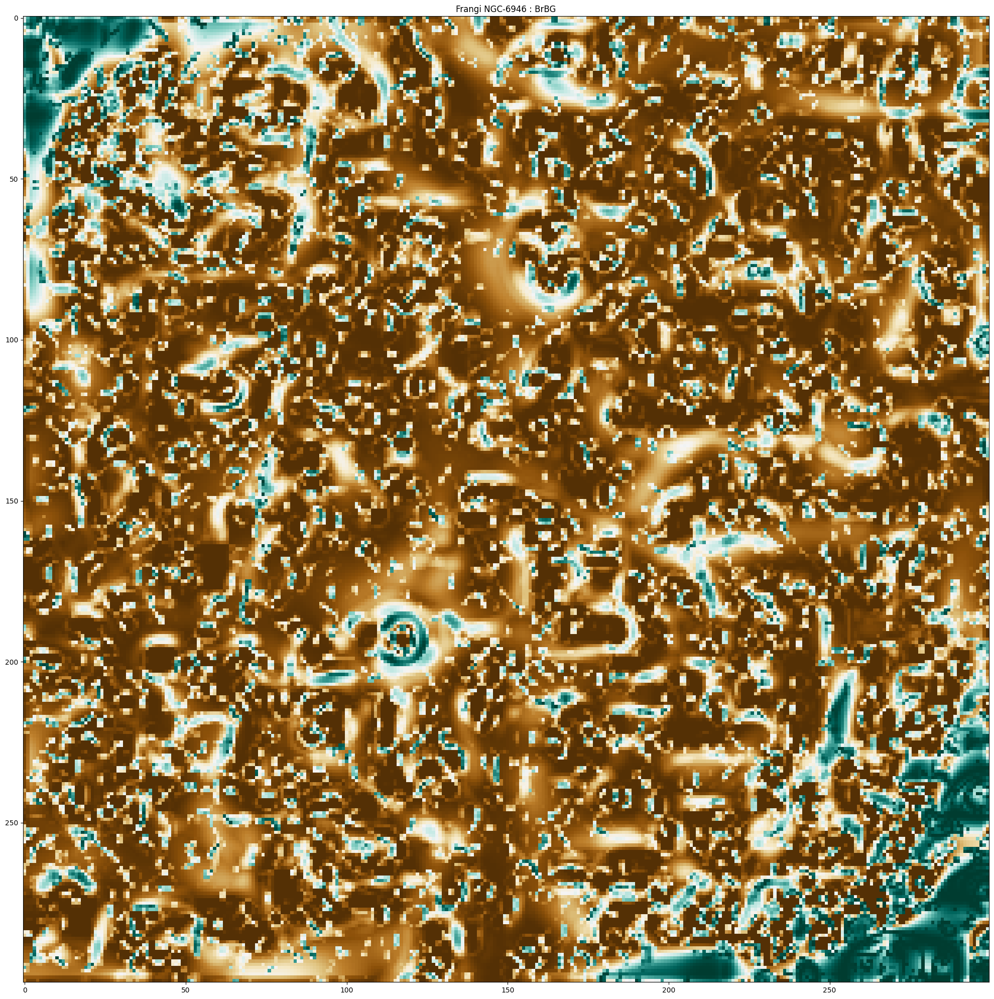

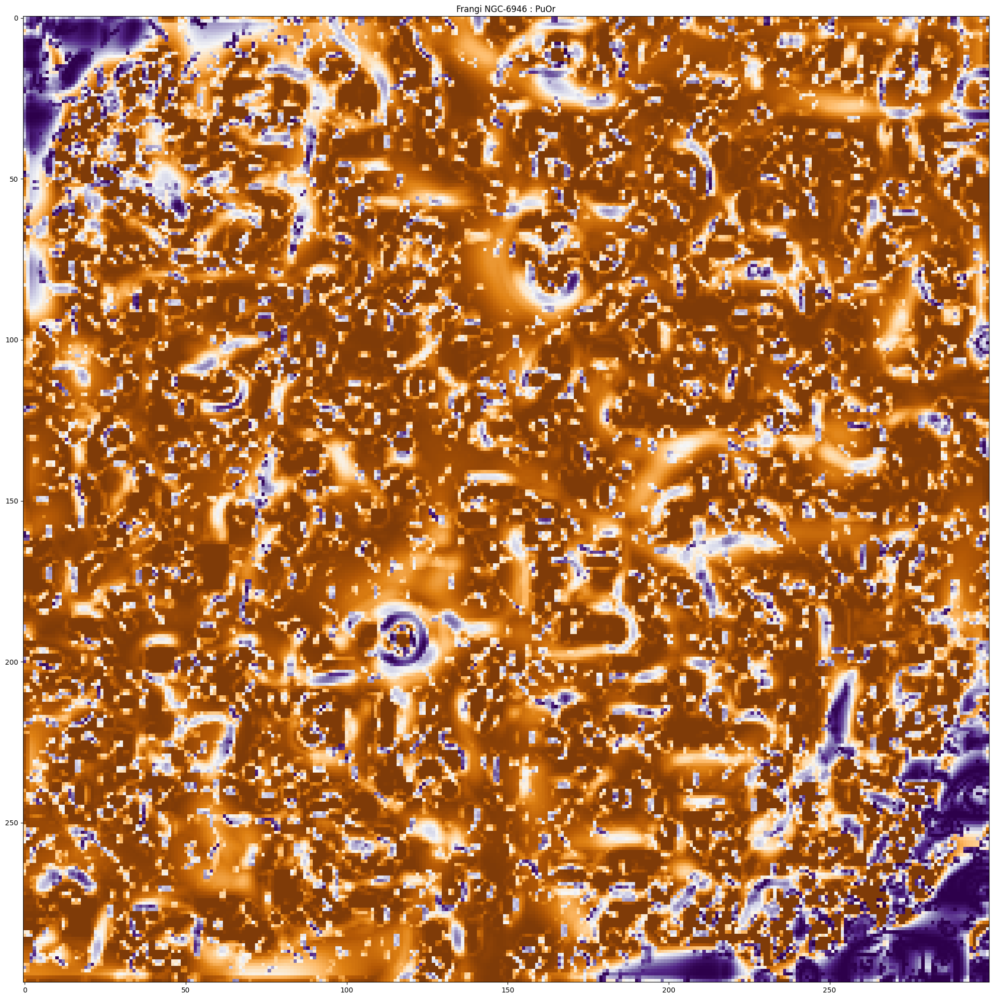

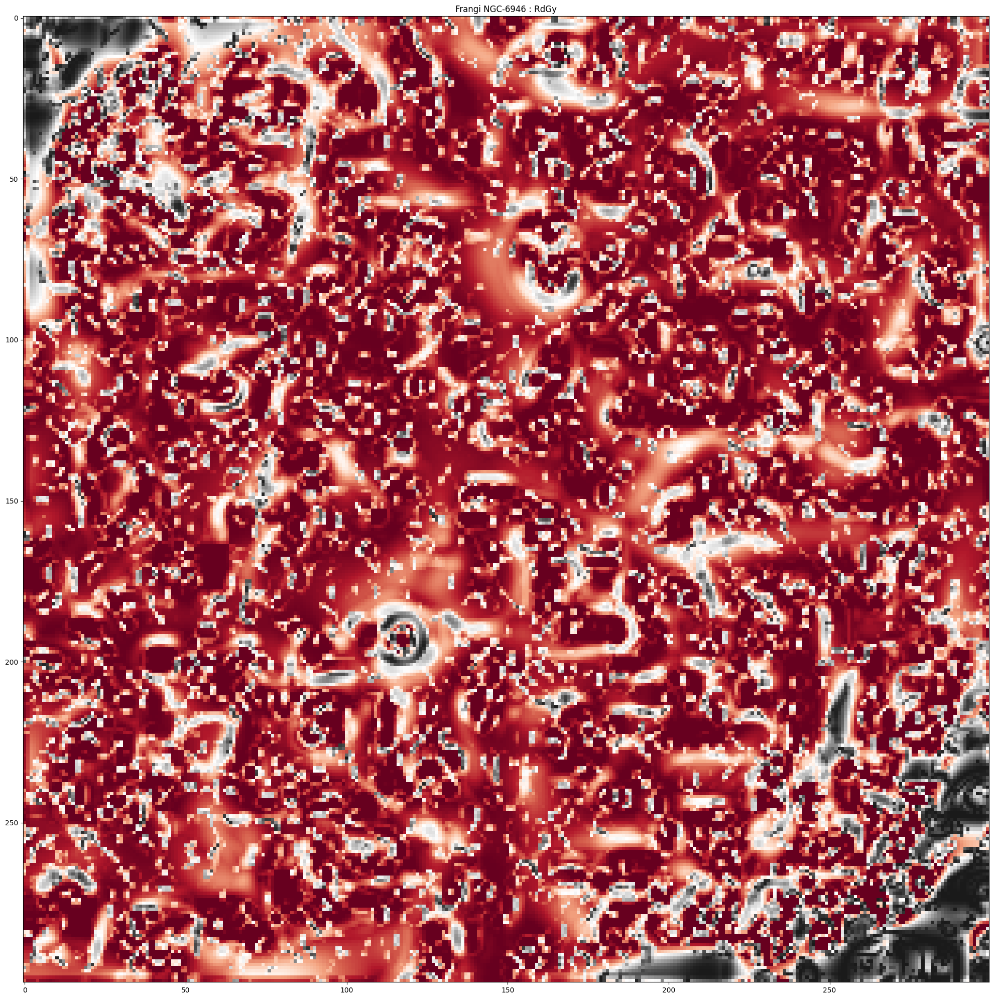

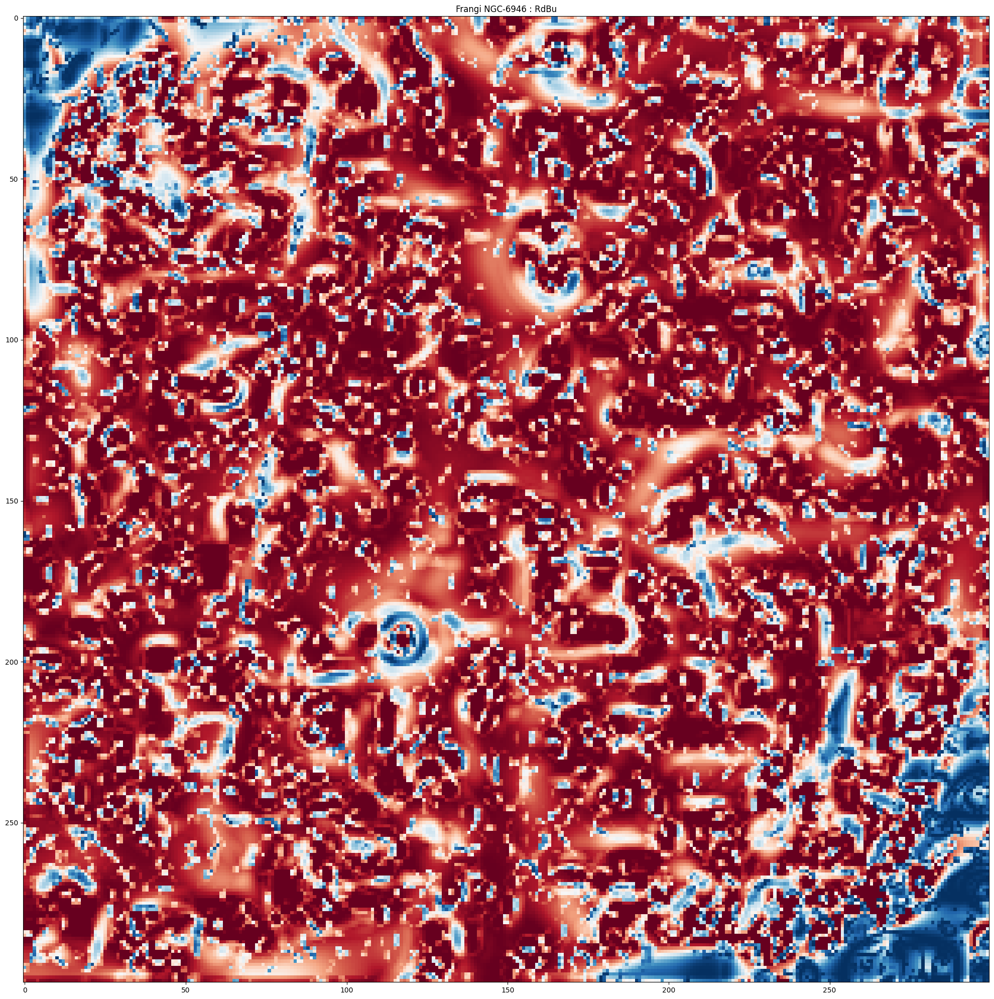

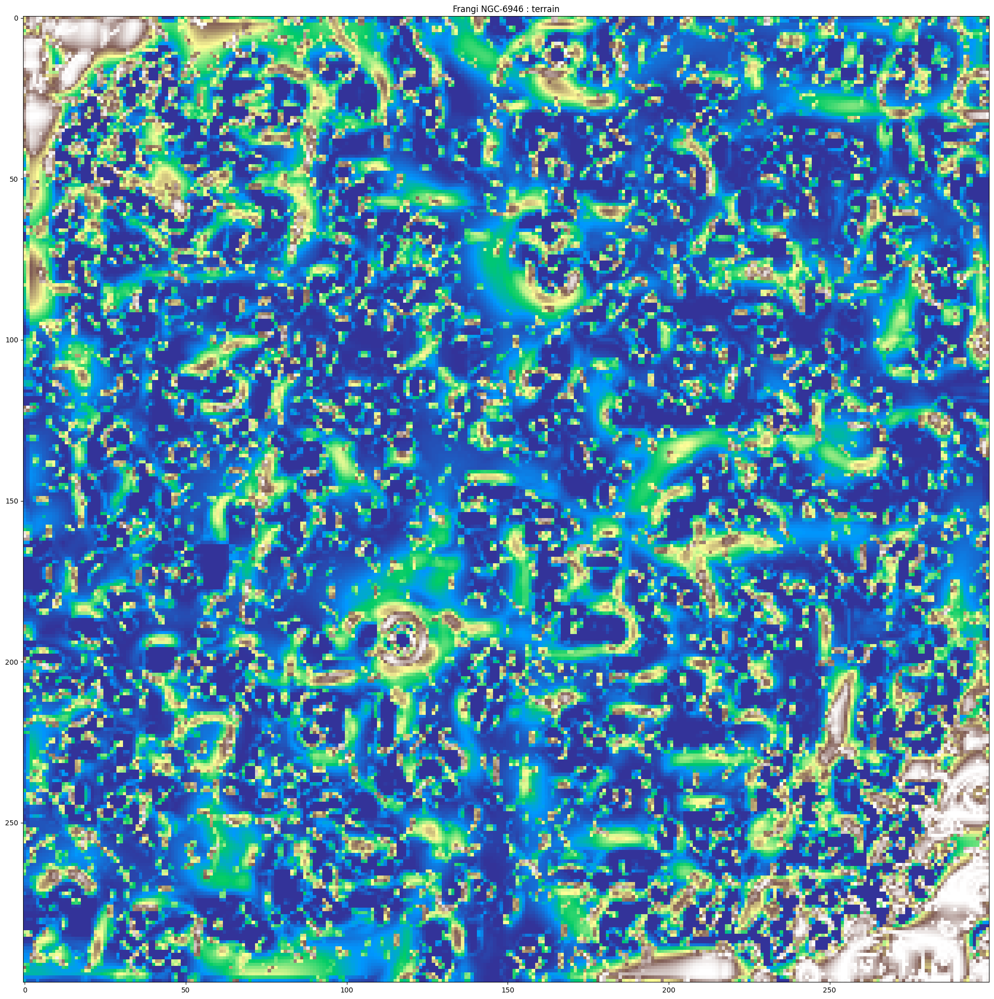

In [ ]:
frangi_6946 = frangi(NGC6946_data)

for x_spec in COLORMAP_LIST:

    plt.figure(figsize=(20,20))

    plt.imshow(frangi_6946 ,cmap=x_spec)
    plt.title("Frangi NGC-6946 : " + x_spec)
    plt.tight_layout()
    plt.show()

Insight

From Filter 1 : We see that this filter ends up looking comparitively more noisy and distorted. It highlights the structure of the spiral arms of the galaxy, tracing out the arms.

The brightness and colour differences also point towards more active parts of the image such as star formation.However, the nucleus is not discernible.

These are best depicted by the color maps : Gray, hot, gist_stern, bwr, RdGy.

Filter 4 : Hessain Filter

Similiar to Frangi, this filter can be used to detect continuous ridges, e.g. neurites, wrinkles, rivers depicted by tube-like structures. It can be used to calculate the fraction of the whole image containing such objects. While it is almost identical to Frangi, it uses a different way of smoothening.

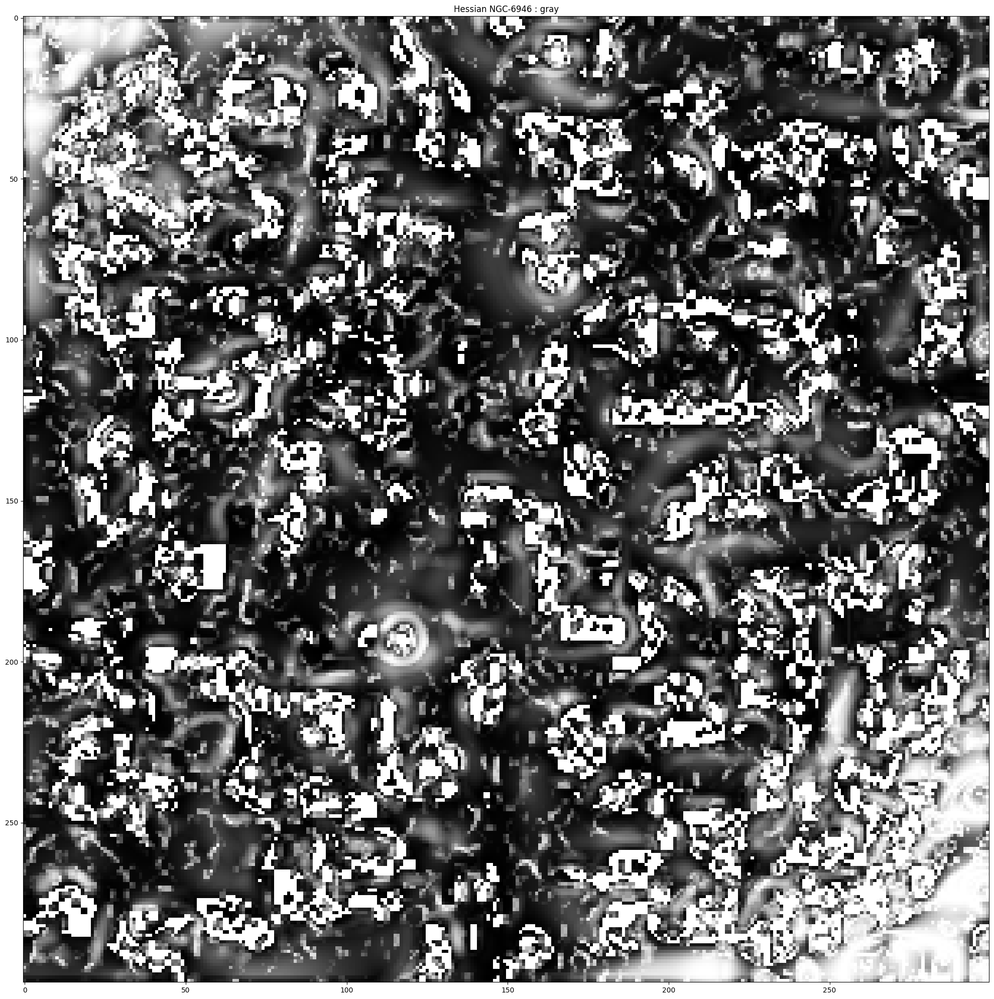

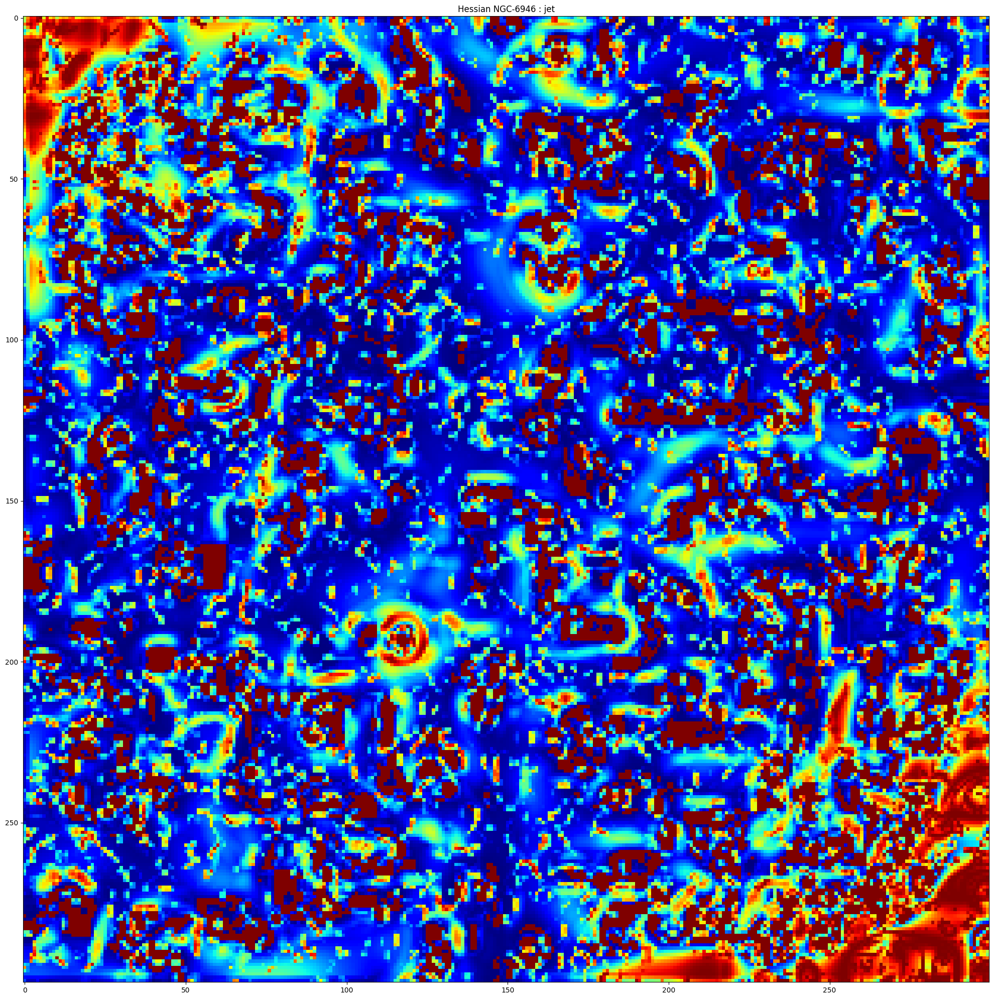

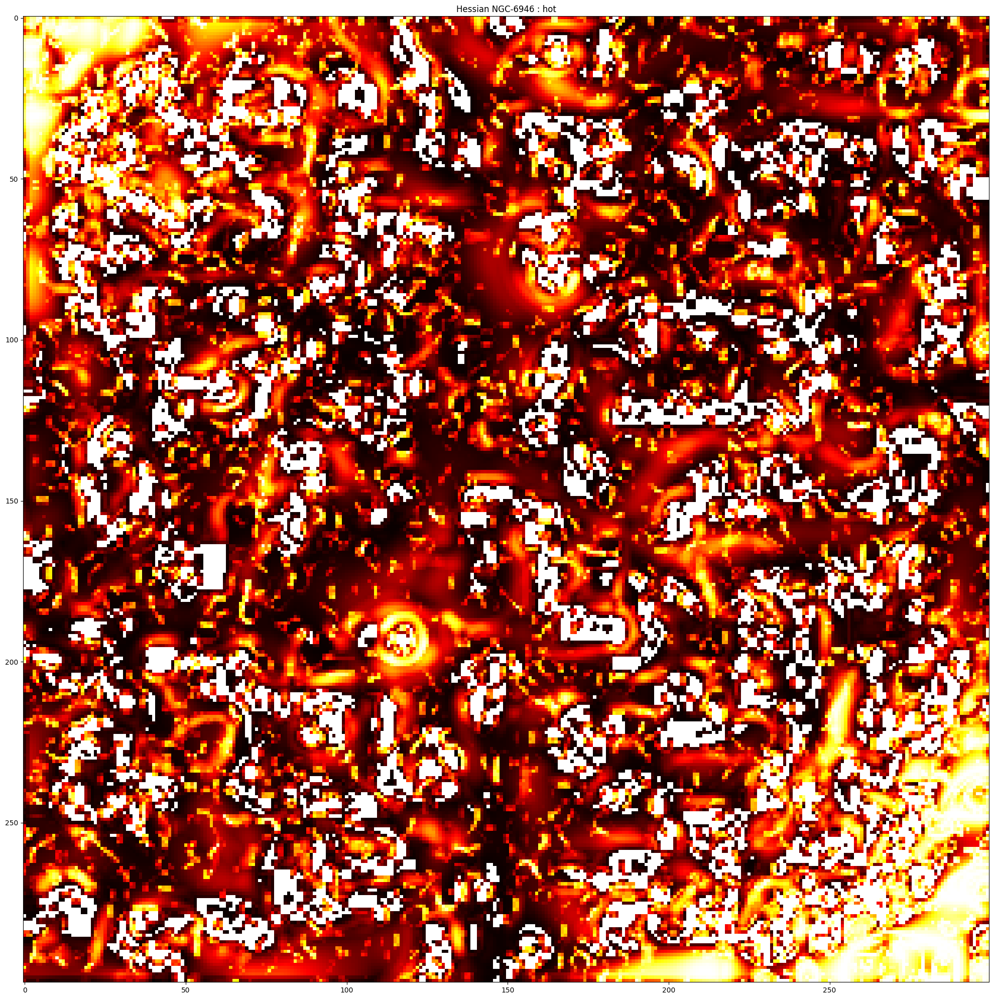

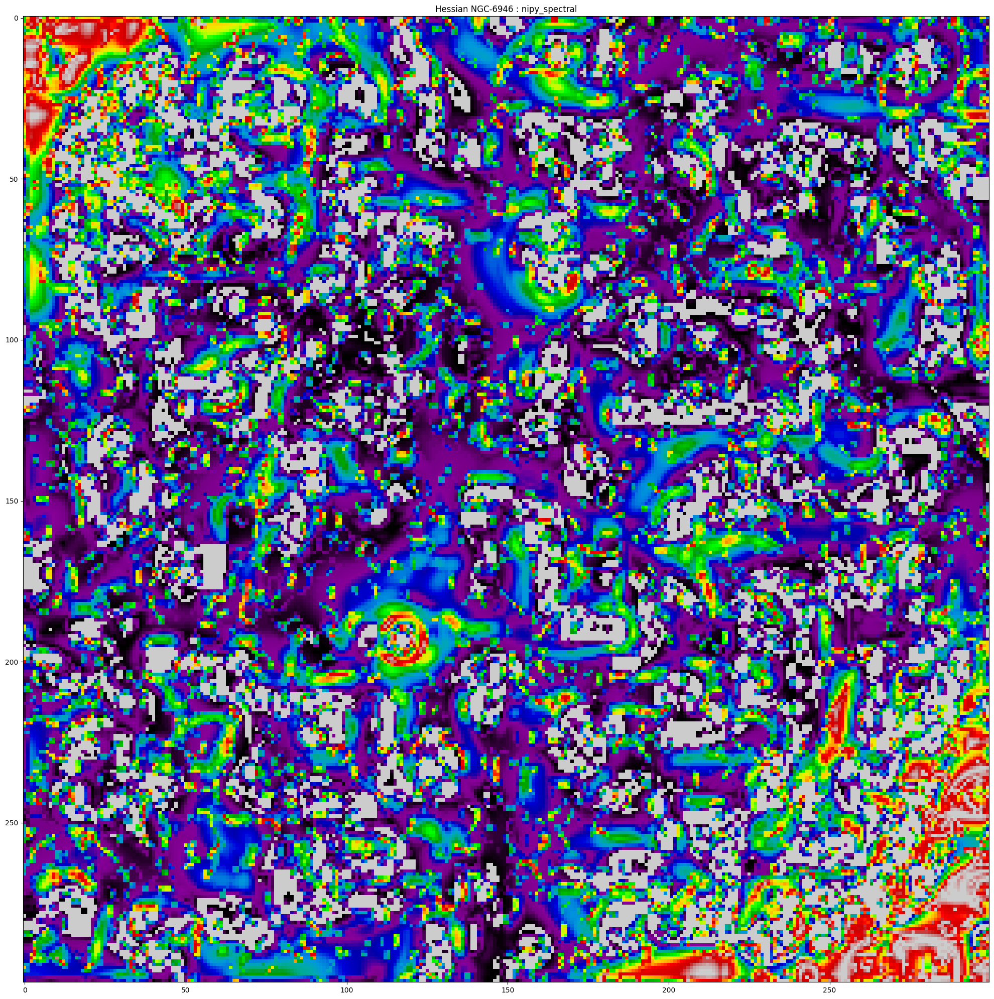

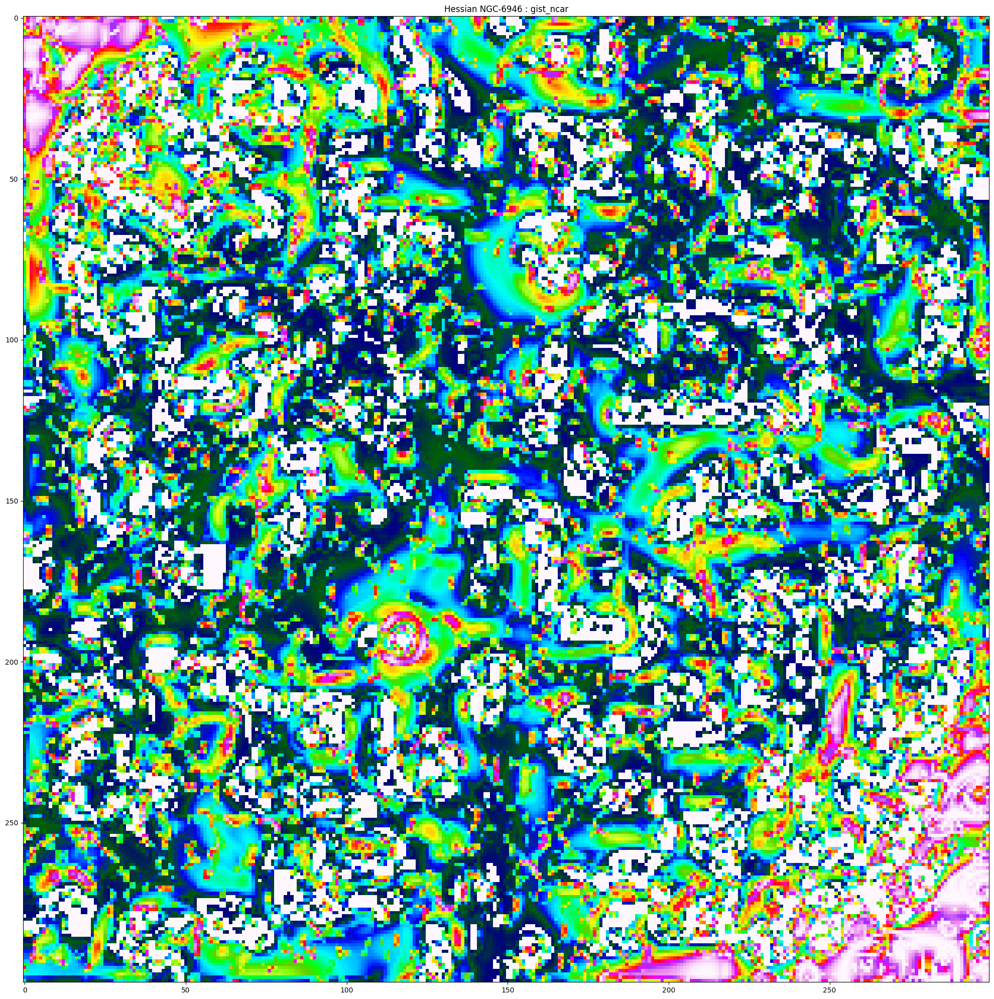

...

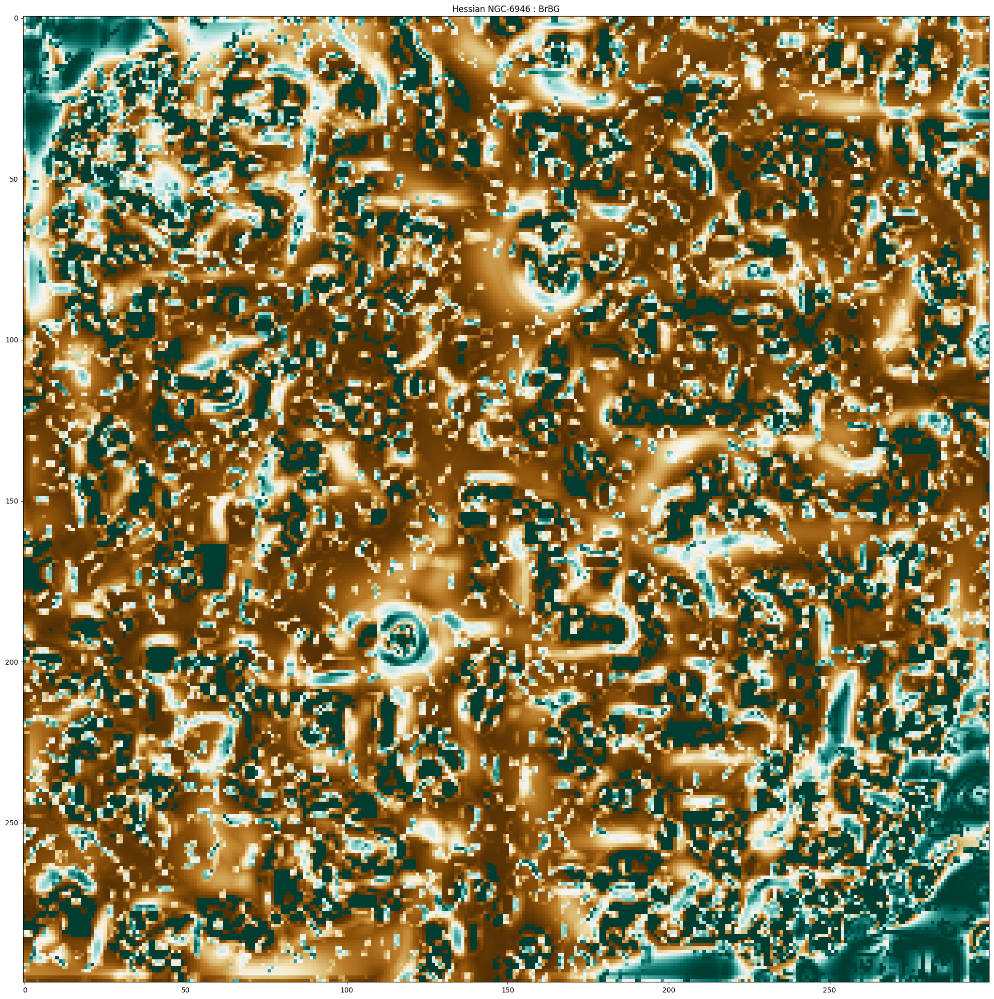

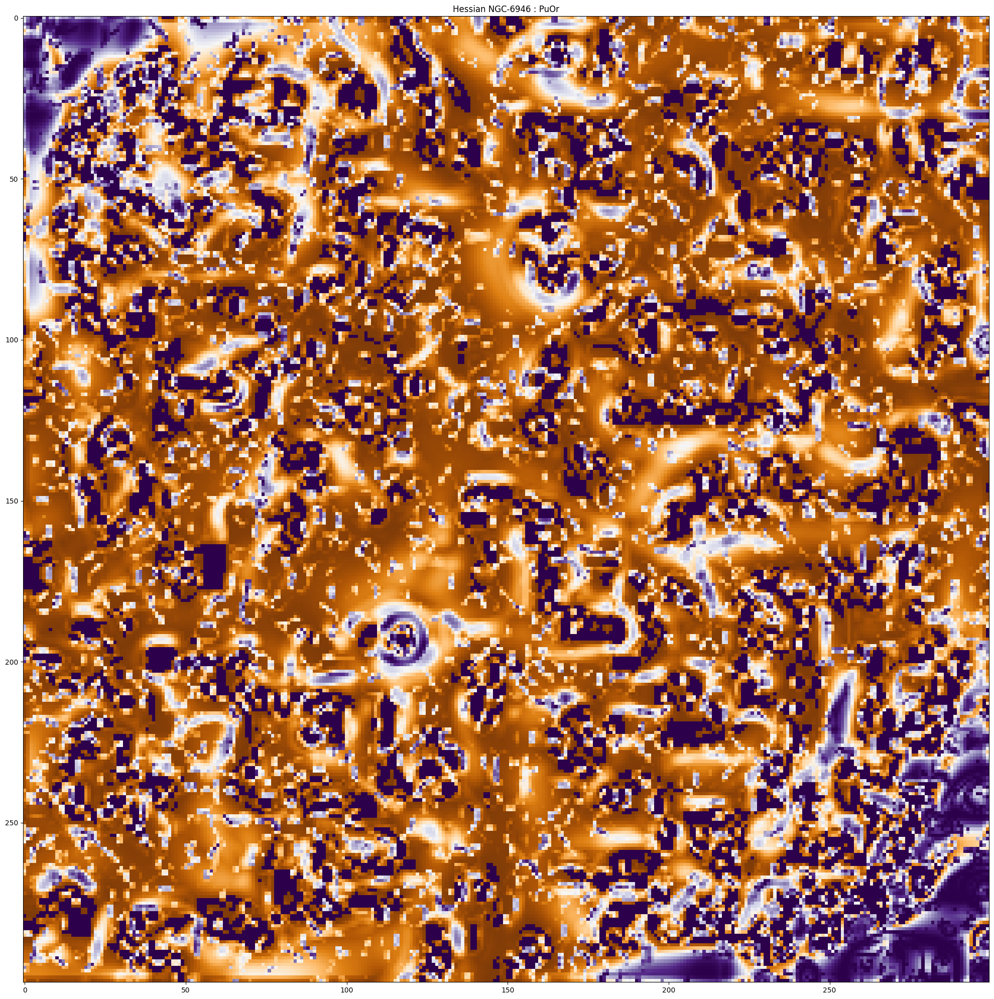

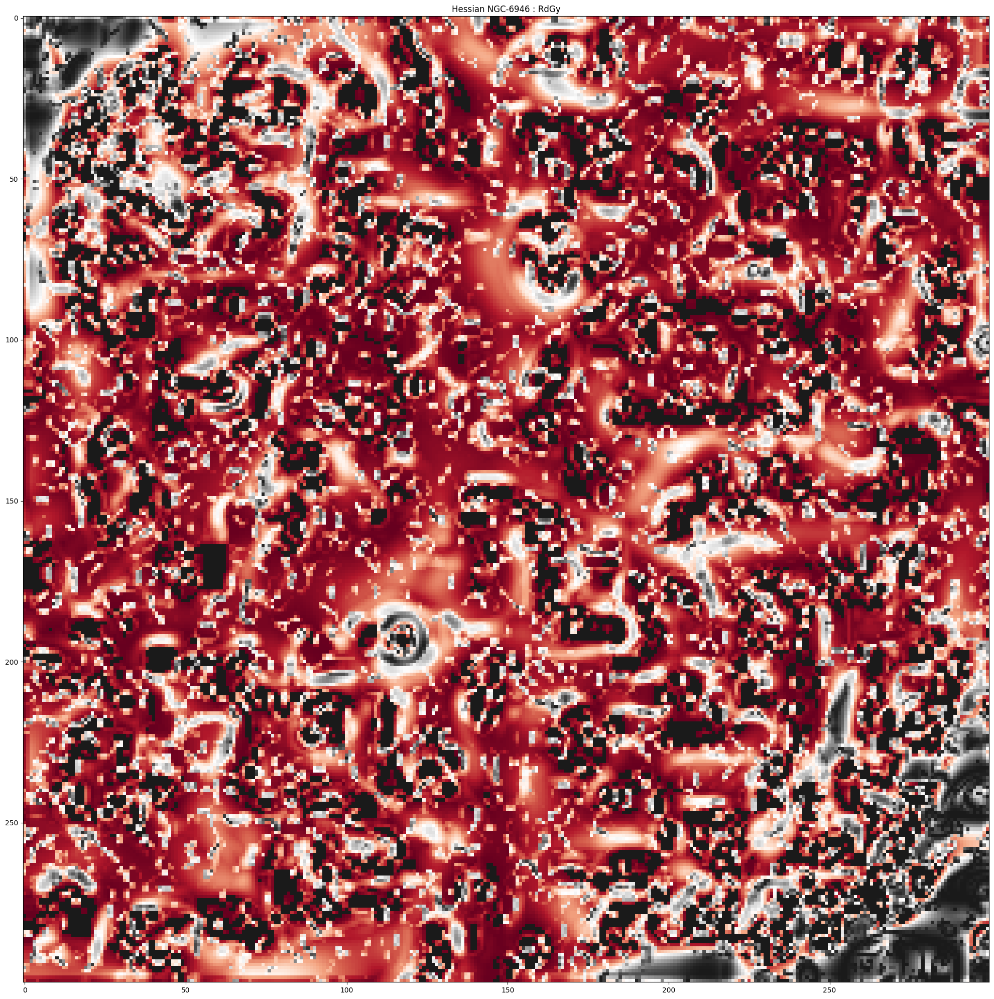

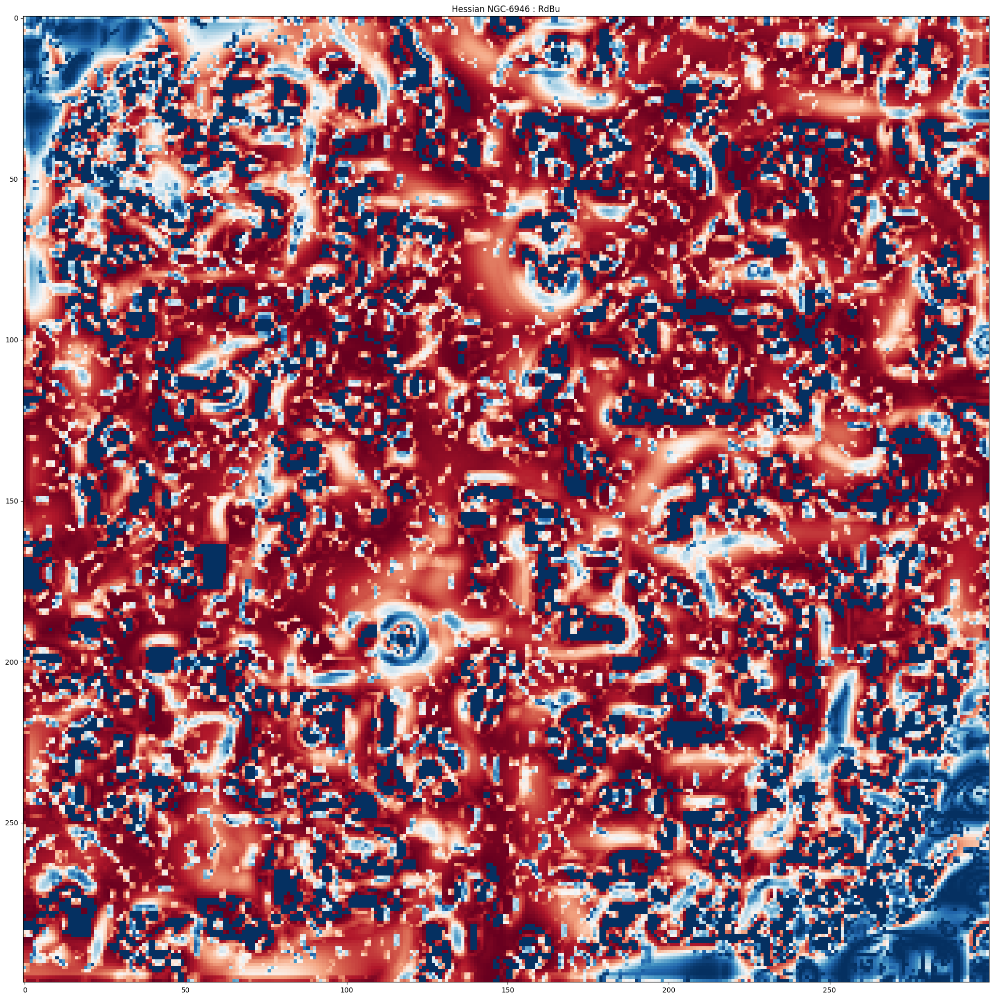

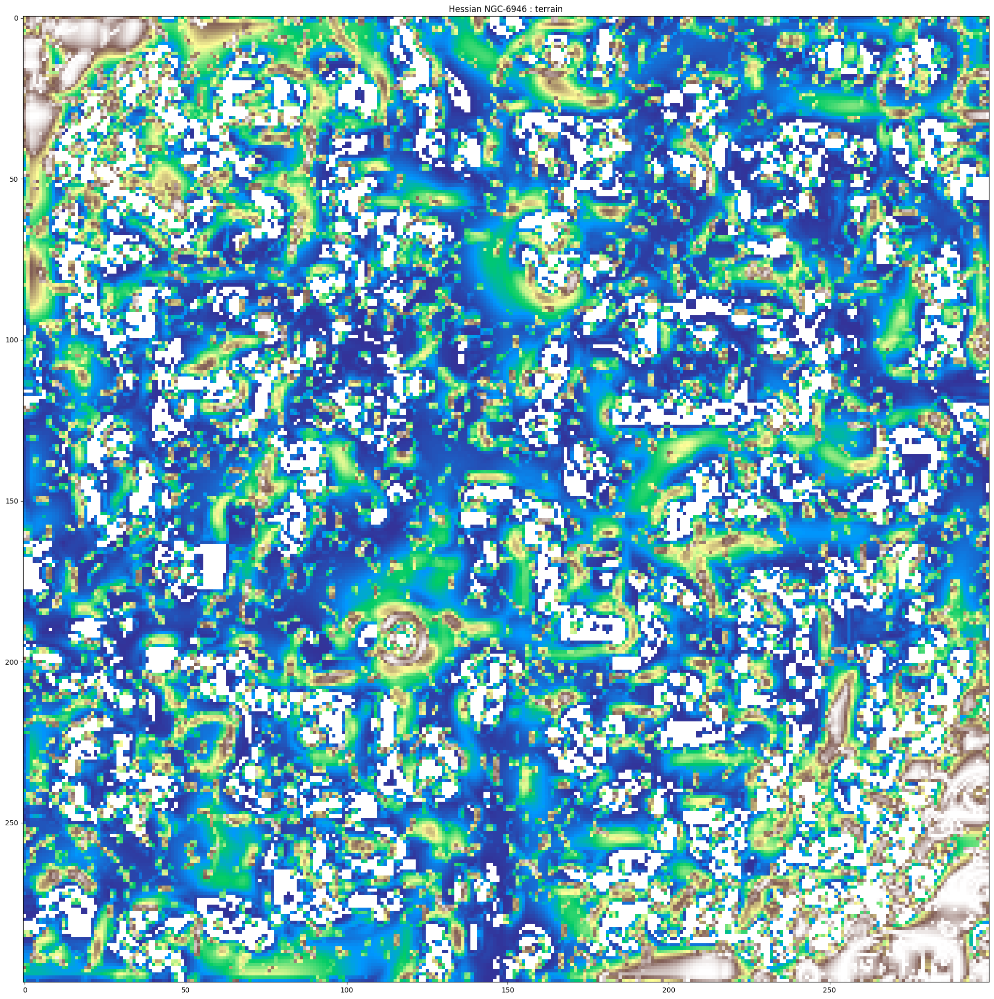

In [ ]:
hessian_6946 = hessian(NGC6946_data)

for x_spec in COLORMAP_LIST:

    plt.figure(figsize=(20,20))

    plt.imshow(hessian_6946 ,cmap=x_spec)
    plt.title("Hessian NGC-6946 : " + x_spec)
    plt.tight_layout()
    plt.show()

Insight

From Filter 4 : We see that this filter looks very noisy and bright. It highlights the structure of the spiral arms of the galaxy, tracing out the arms. However, it it has much less contrast in comparison to Frangi Filter.

The brightness and colour differences also point towards more active parts of the image such as star formation. However, the nucleus is still not discernible.

These are best depicted by the color maps : Hot, gist_stern, PuOr, RdGy.

In [ ]:
print('''In conclusion :
 NGC - 6946 galaxy is very accurately named as the Fireworks Galaxy. There is constant star formation with frequent supernovas. The galaxy is brimming with
 activity and is beautiful spiral with stars lining all arms with intensity. There is also high chances of there being a Super massive Blackhole in the middle of
 the galaxy. All in all, the galaxy is extremely active and evolving''')


In conclusion : 
 NGC - 6946 galaxy is very accurately named as the Fireworks Galaxy. There is constant star formation with frequent supernovas. The galaxy is brimming with
 activity and is beautiful spiral with stars lining all arms with intensity. There is also high chances of there being a Super massive Blackhole in the middle of
 the galaxy. All in all, the galaxy is extremely active and evolving
